In [1]:
import squidpy as sq
import scanpy as sc
import pandas as pd 
import numpy as np 
import sys
import os
sys.path.append(os.path.abspath(os.path.join(os.getcwd(), '../..')))
from adipo_finder import utils as seg_utils
from adipo_finder import segmentation as seg
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")
import adipo_finder.new_adipofinder_code as nac

/home/jgustafs/miniconda3/envs/adipo_env/lib/python3.10/site-packages/dask/dataframe/__init__.py:31: FutureWarning: The legacy Dask DataFrame implementation is deprecated and will be removed in a future version. Set the configuration option `dataframe.query-planning` to `True` or None to enable the new Dask Dataframe implementation and silence this warning.
  warnings.warn(
/home/jgustafs/miniconda3/envs/adipo_env/lib/python3.10/site-packages/anndata/utils.py:434: FutureWarning: Importing read_text from `anndata` is deprecated. Import anndata.io.read_text instead.
  warnings.warn(msg, FutureWarning)


In [2]:
adata = sc.read('../../../data/spe_final.h5ad')

In [3]:
libraries=adata.obs['library_id'].unique()
missing_cols=['width_px', 'height_px','sample_id','tissue_id','slide_id', 'timepoint', 'patient_n', 'DFCI_id', 'MRN']
cell_annot_key=['major_cell_type','medium_cell_type','minor_cell_type','functional_cell_type']

In [4]:
import os
os.makedirs("../../../old_predictions/", exist_ok=True)
os.makedirs("../../../old_prediction_plots/", exist_ok=True)


In [5]:
from PIL import Image

def test_params(adata,library_id,sigma=2,min_size=100,max_size=6000,window=15,pixels=3,
                                              image_path = "../../../old_predictions/", 
                                              plot_path = "../../../old_prediction_plots/"):
    old_seg,img=seg_utils.Preprocessing.preprocess_image(adata=adata,library_id=library_id, sigma=sigma)
    new_img=seg.Segmentation.run_segmentation(image=img, 
                                              min_size=min_size,max_size=max_size,
                                              window=window,
                                              pixels=pixels)
    new_seg,df=seg_utils.Exporting.export_adipocytes(segmentation_image=old_seg,new_segmentation=new_img)
    shuffled = nac.shuffle_labels(new_img)
    img = Image.fromarray(shuffled.astype(np.uint16))
    img.save(image_path + library_id + " pred_adipocytes.png")
    #also make a plot
    bin_mask = old_seg != 0
    nac.prediction_plot(bin_mask, shuffled, shuffled, 
                    None, filename = plot_path + library_id + " prediction_plot.png", show_plot = False)

    image_path
    fig,axes=plt.subplots(1,3,figsize=(15,8))
    axes[0].imshow(old_seg)
    axes[1].imshow(new_img)
    axes[2].imshow(new_seg)
    plt.title(library_id)
    plt.tight_layout()
    plt.show()

    seg_utils.Plotting.plot_centroids(new_img, figsize=(8,8))

    return df, new_seg

def update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg):
    df_exp= seg_utils.Exporting.expand_df(adata=adata,
                                          df=df,
                                          library_id=library_id,
                                          missing_columns=missing_cols,
                                          cell_annot_key=cell_annot_key)
    adata_adipo = seg_utils.Exporting.create_adipo_adata(adata=adata,
                                                         df=df_exp) 
    adata_new=seg_utils.Exporting.merge_adatas(adata=adata,
                                               adata_tmp=adata_adipo,
                                               new_segmentation=new_seg,
                                               library_id=library_id)
    return adata_new

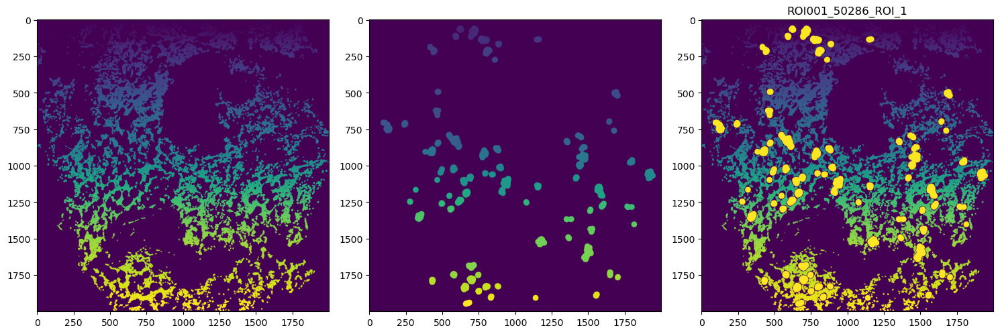

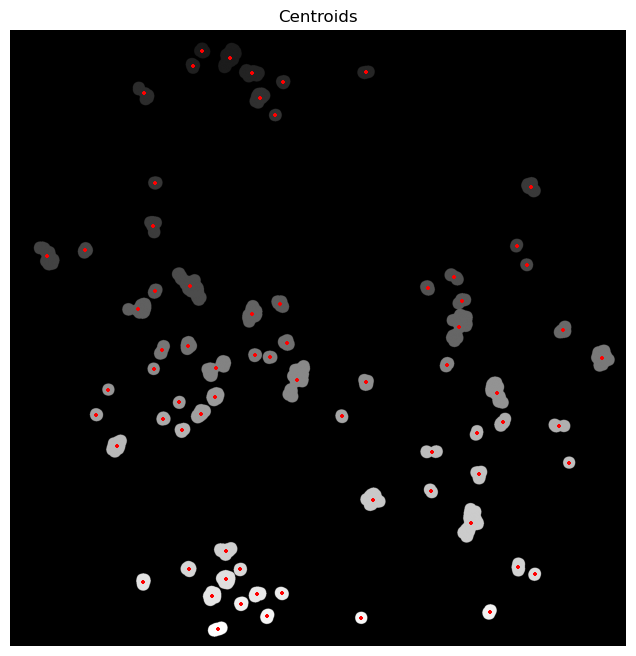

In [6]:
library_id=libraries[0]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=50,max_size=6000,window=15,pixels=5)

In [7]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

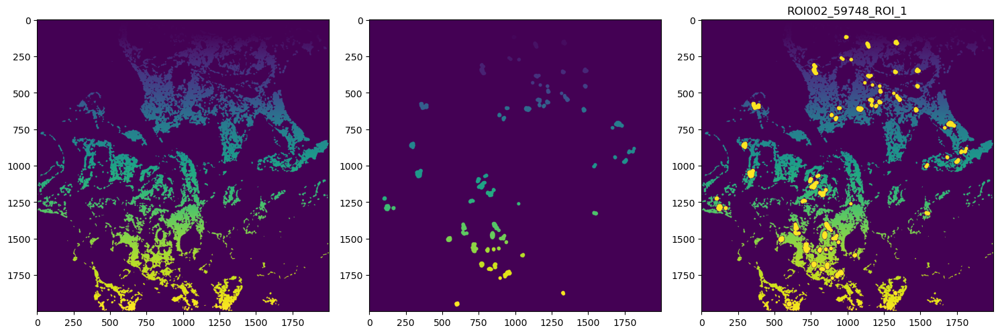

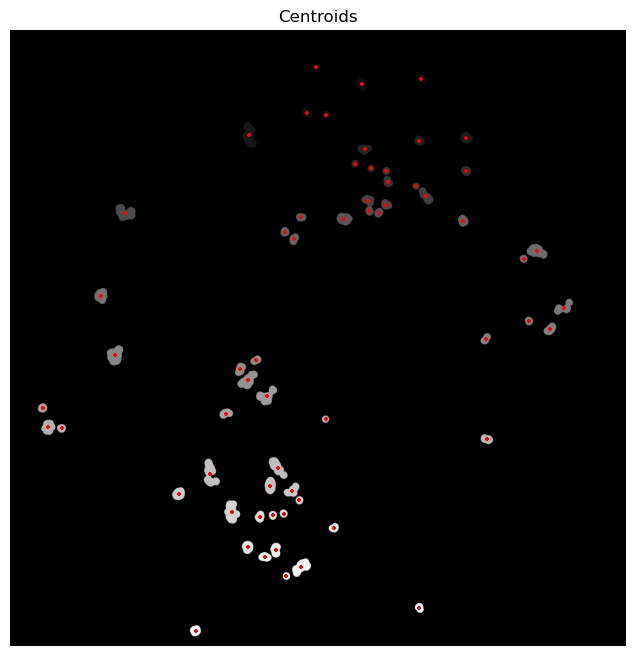

In [8]:
library_id=libraries[1]
df,new_seg=test_params(adata,library_id,sigma=1,min_size=200,max_size=3000,window=10,pixels=2)

In [9]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

In [10]:
# library_id=libraries[2]
# df,new_seg=test_params(adata,library_id,sigma=2,min_size=50,max_size=6000,window=15,pixels=5)

In [11]:
# adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

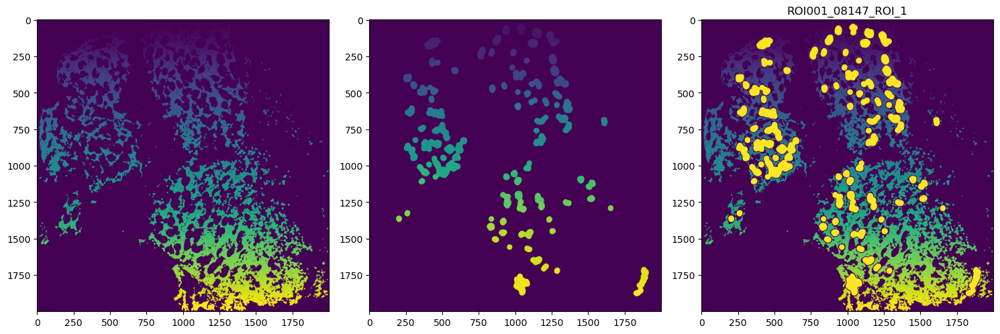

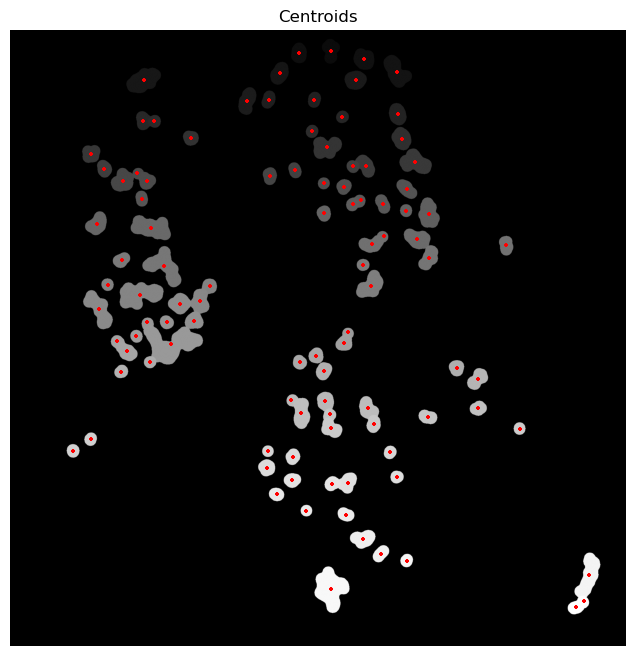

In [12]:
library_id=libraries[3]
df,new_seg=test_params(adata,library_id,sigma=5,min_size=50,max_size=10000,window=5,pixels=14)

In [13]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

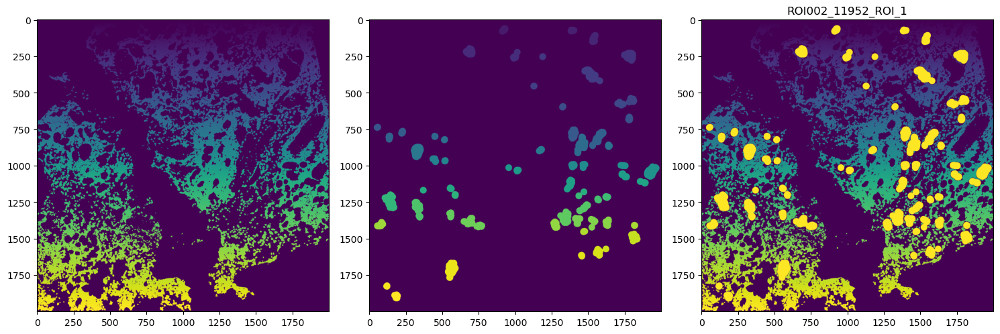

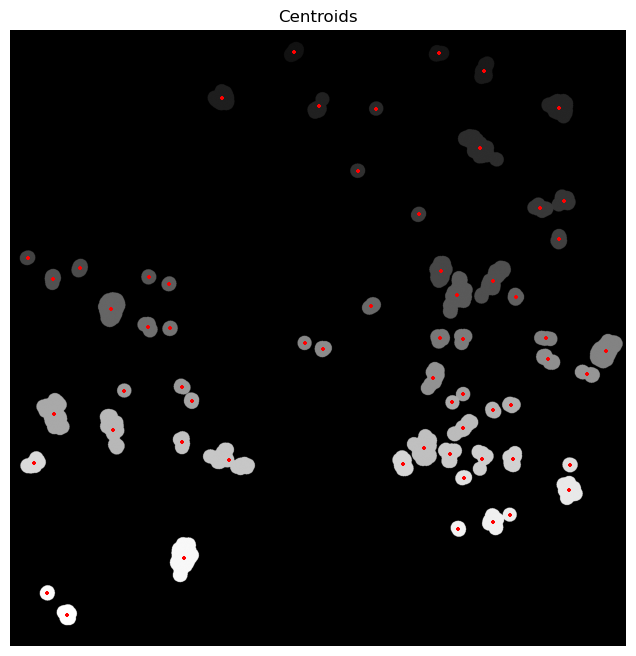

In [14]:
library_id=libraries[4]
df,new_seg=test_params(adata,library_id,sigma=1,min_size=100,max_size=9000,window=20,pixels=3)

In [15]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

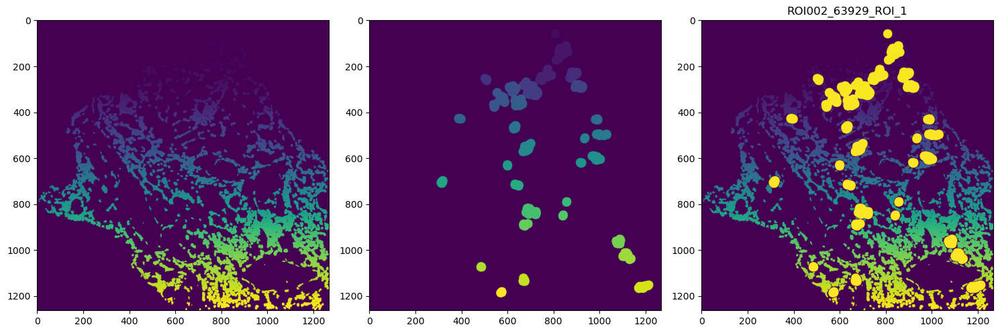

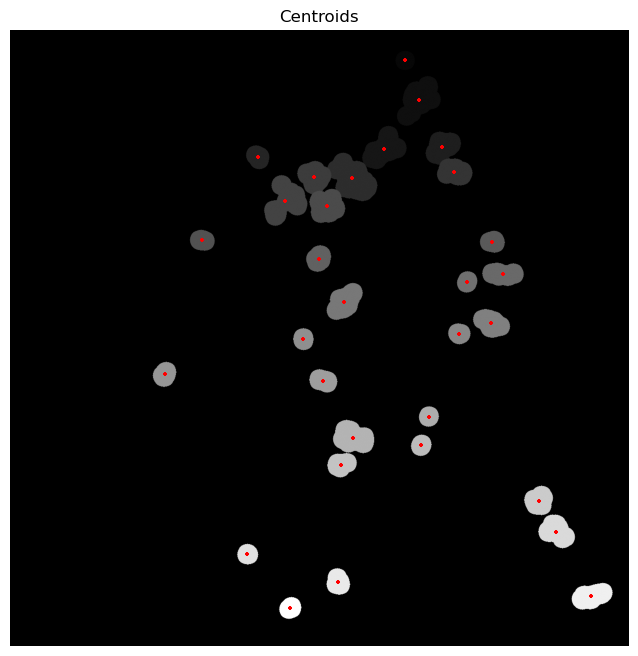

In [16]:
library_id=libraries[5]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=50,max_size=6000,window=15,pixels=5)

In [17]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

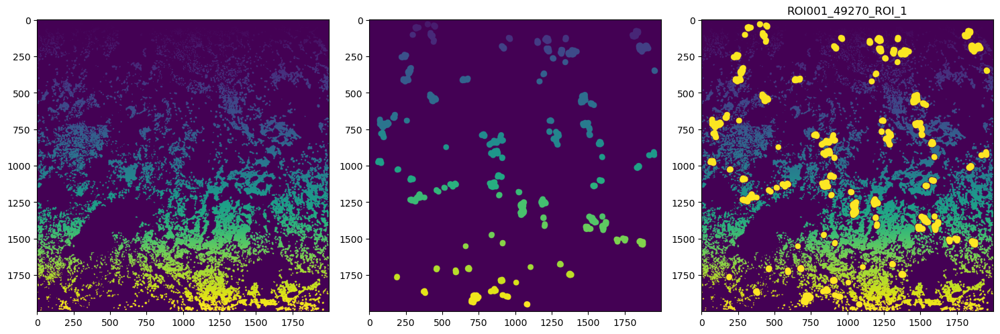

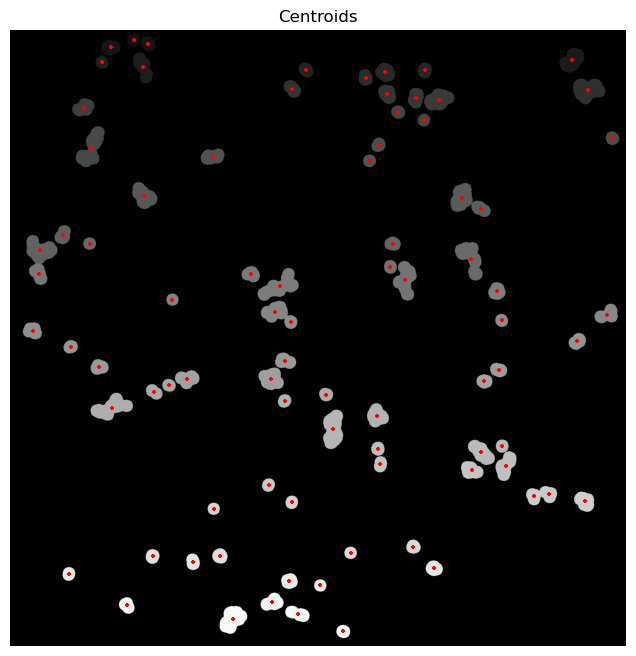

In [18]:
library_id=libraries[6]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=50,max_size=6000,window=15,pixels=5)

In [19]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

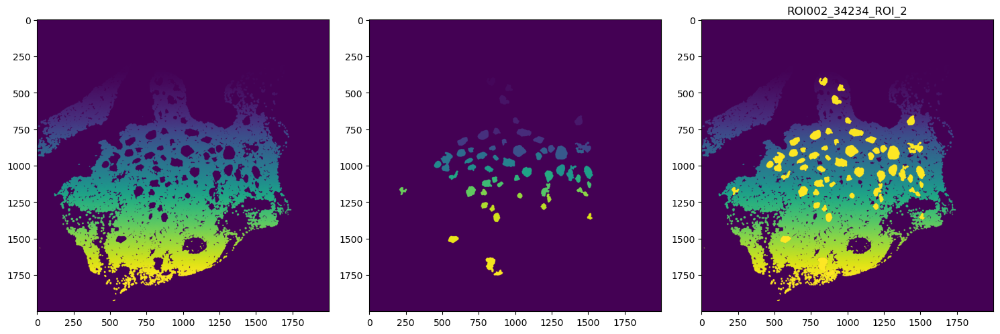

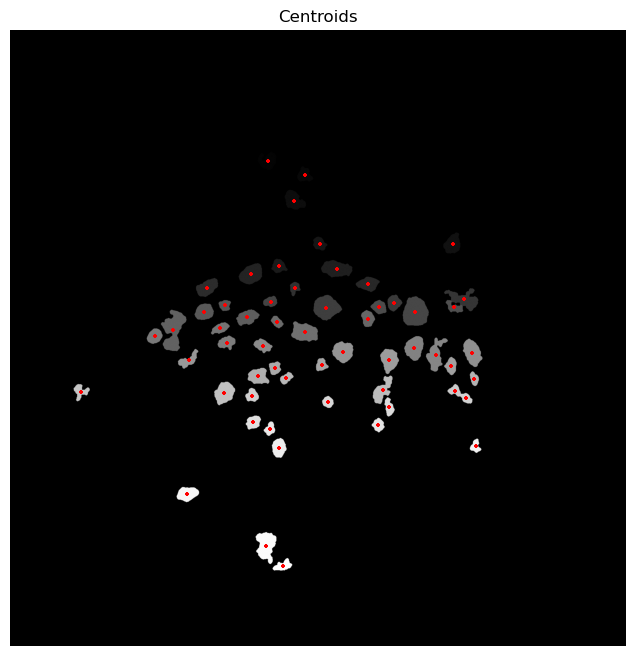

In [20]:
library_id=libraries[7]
df,new_seg=test_params(adata,library_id,sigma=1,min_size=500,max_size=6000,window=1,pixels=4)

In [21]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

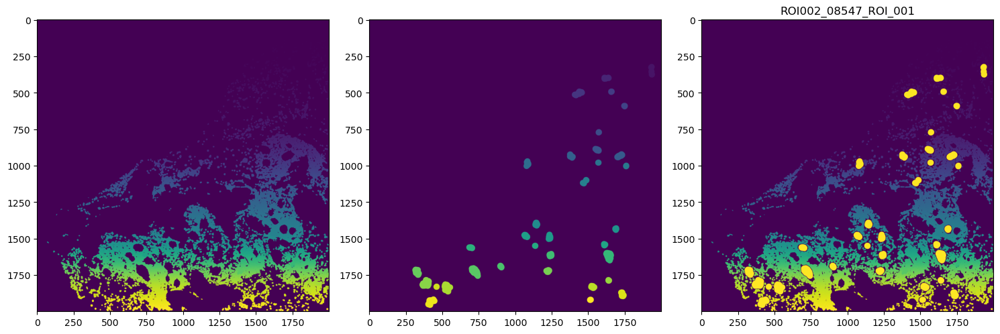

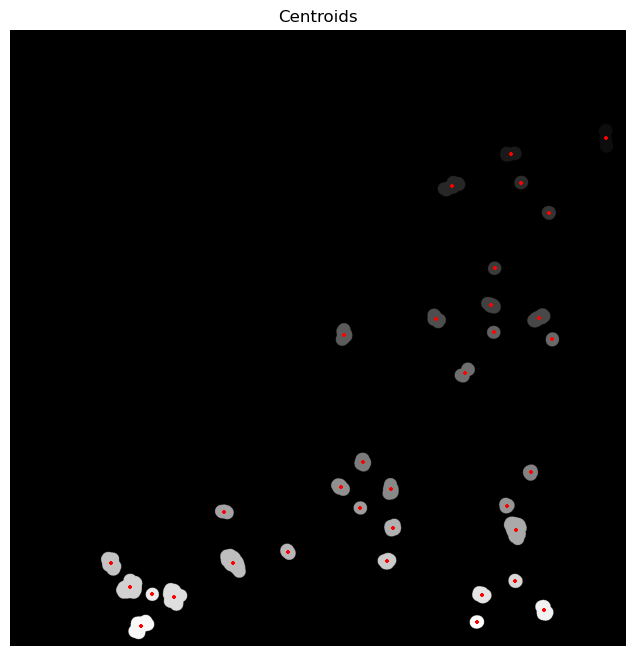

In [22]:
library_id=libraries[8]
df,new_seg=test_params(adata,library_id,sigma=1,min_size=50,max_size=6000,window=20,pixels=1)

In [23]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

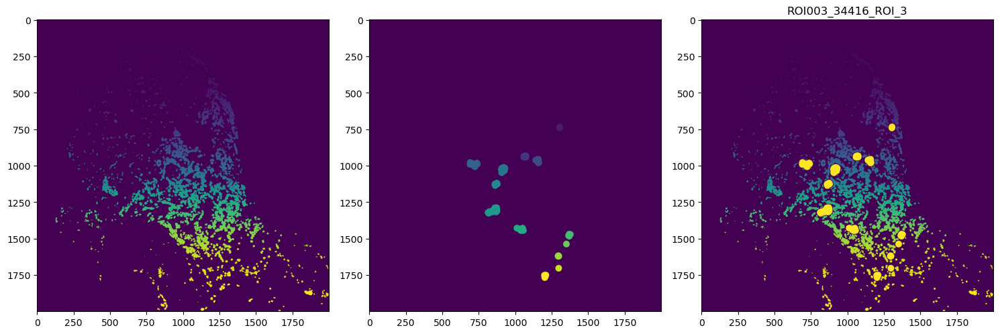

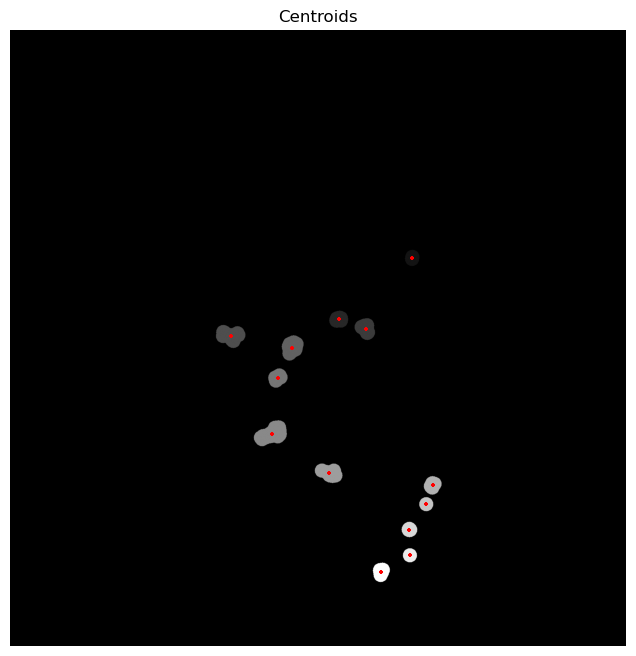

In [24]:
library_id=libraries[9]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=1000,max_size=6000,window=20,pixels=3)

In [25]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

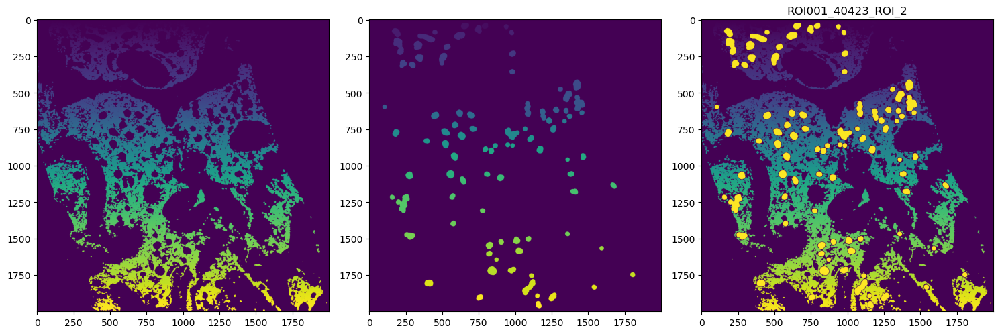

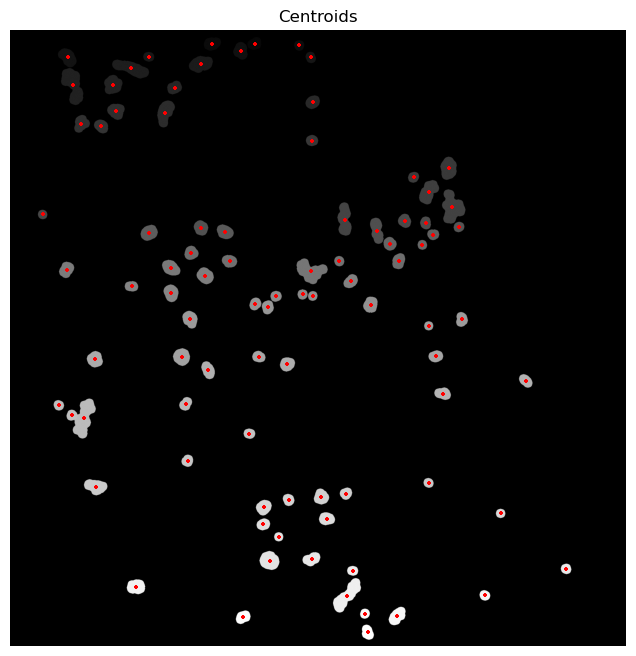

In [26]:
library_id=libraries[10]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=50,max_size=6000,window=10,pixels=5)

In [27]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

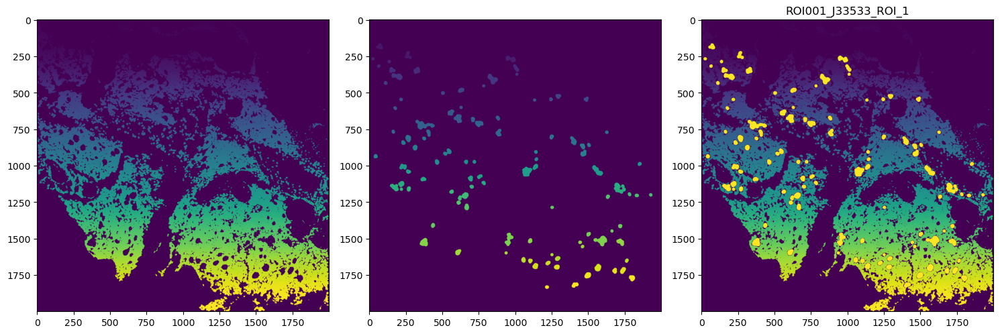

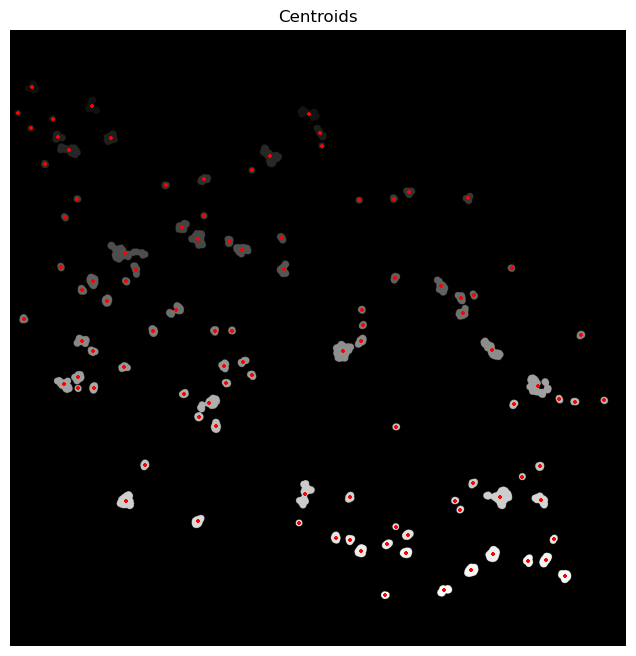

In [28]:
library_id=libraries[11]
df,new_seg=test_params(adata,library_id,sigma=0.5,min_size=200,max_size=6000,window=10,pixels=1)

In [29]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

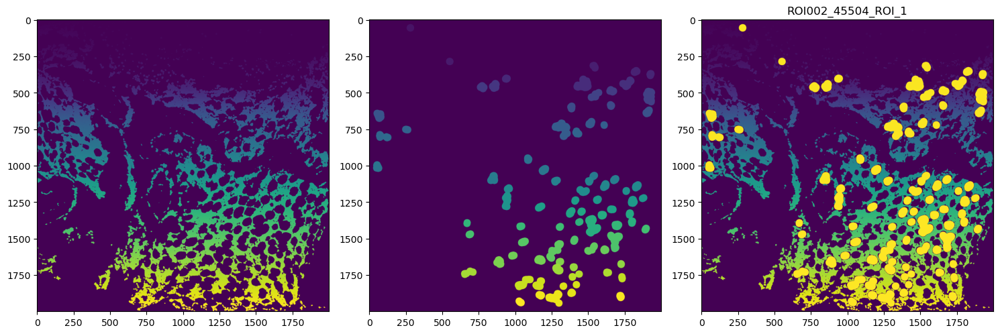

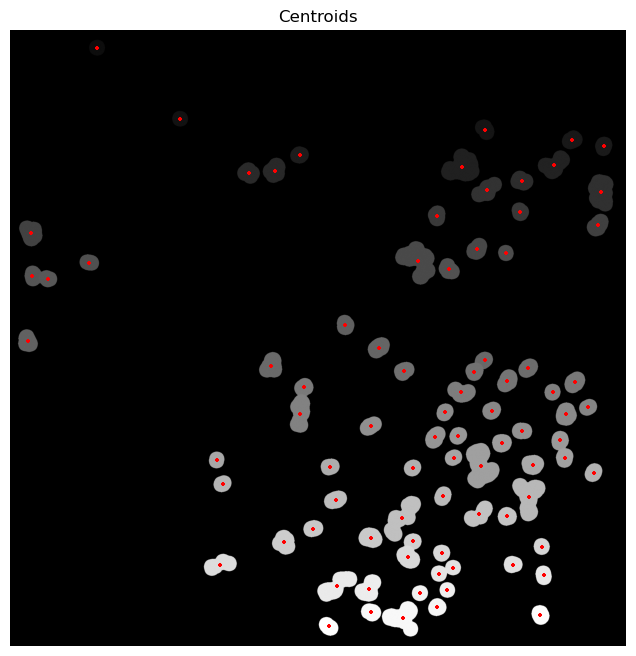

In [30]:
library_id=libraries[12]
df,new_seg=test_params(adata,library_id,sigma=3,min_size=50,max_size=7000,window=15,pixels=10)

In [31]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

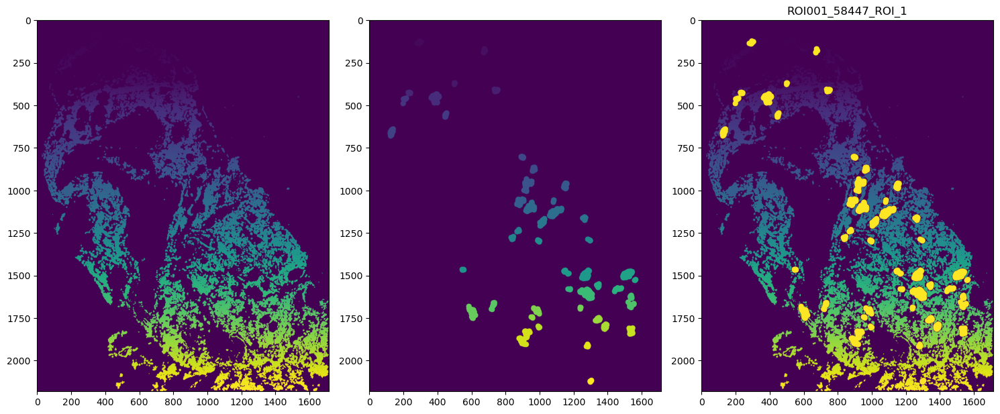

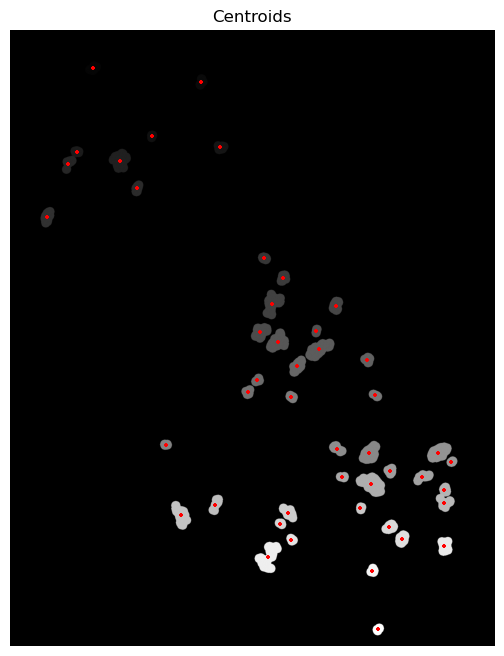

In [32]:
library_id=libraries[13]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=500,max_size=5000,window=10,pixels=6)

In [33]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

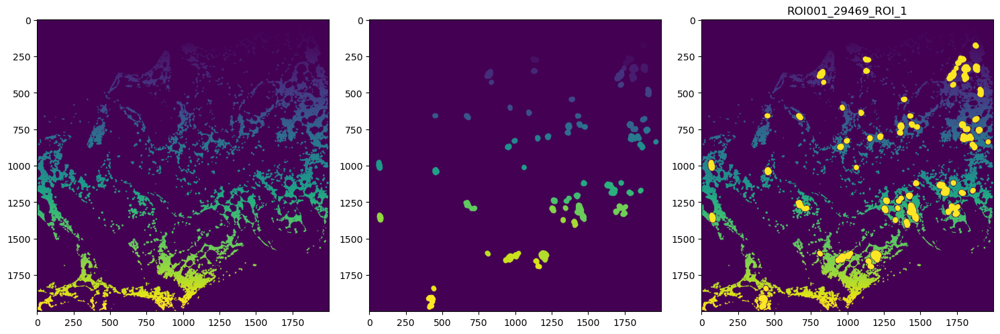

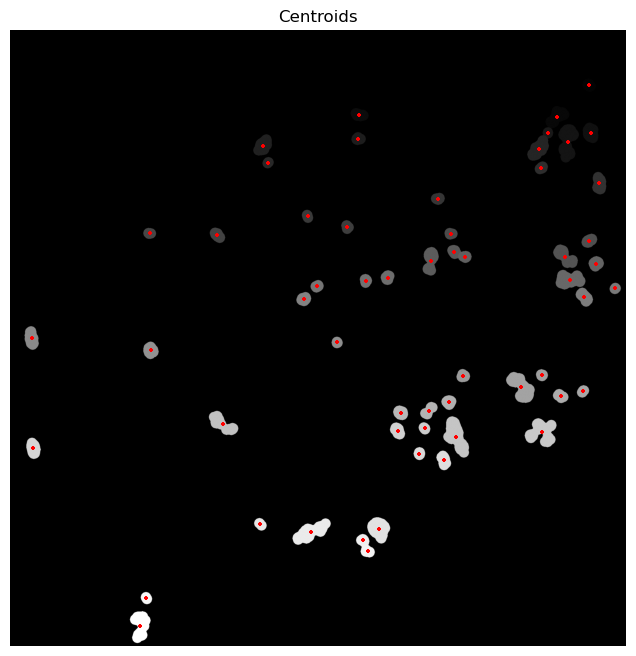

In [34]:
library_id=libraries[14]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=500,max_size=5000,window=12,pixels=5)

In [35]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

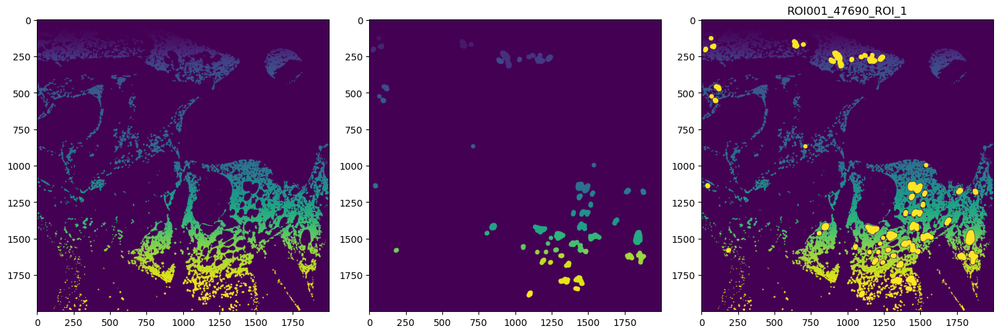

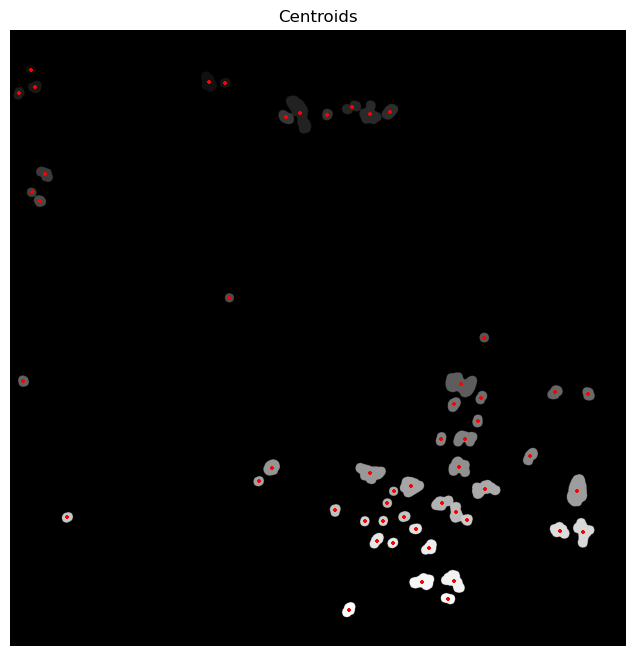

In [36]:
library_id=libraries[15]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=50,max_size=5000,window=10,pixels=5)

In [37]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

In [38]:
# library_id=libraries[16]
# df,new_seg=test_params(adata,library_id,sigma=5,min_size=50,max_size=6000,window=10,pixels=8)

In [39]:
# adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

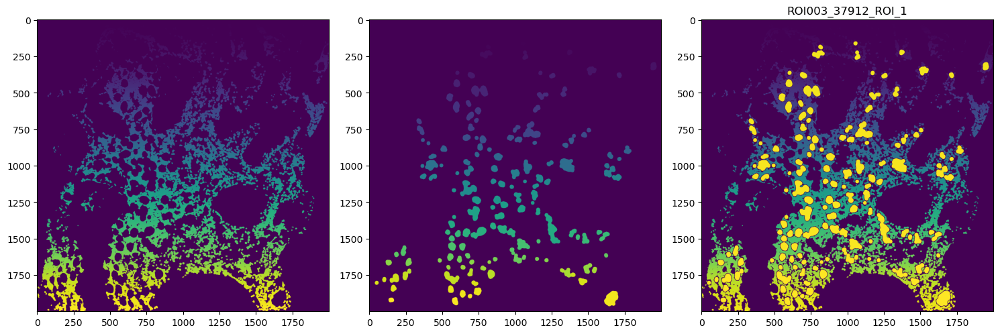

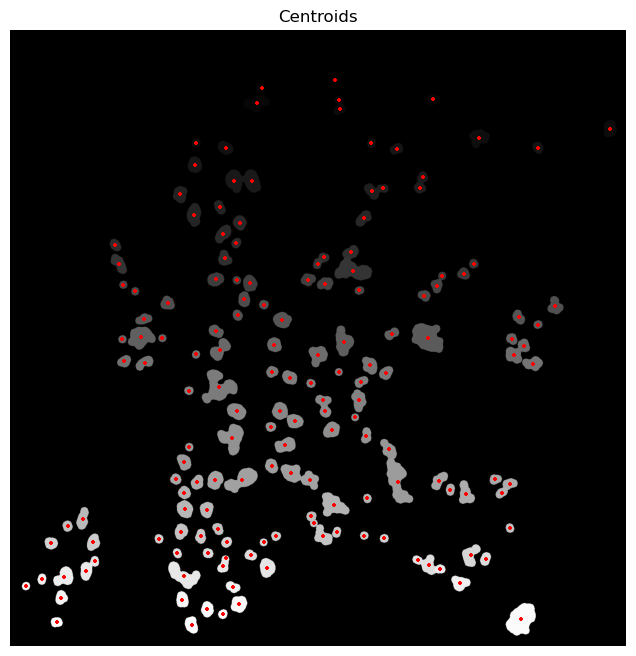

In [40]:
library_id=libraries[17]
df,new_seg=test_params(adata,library_id,sigma=3,min_size=50,max_size=5000,window=5,pixels=8)

In [41]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

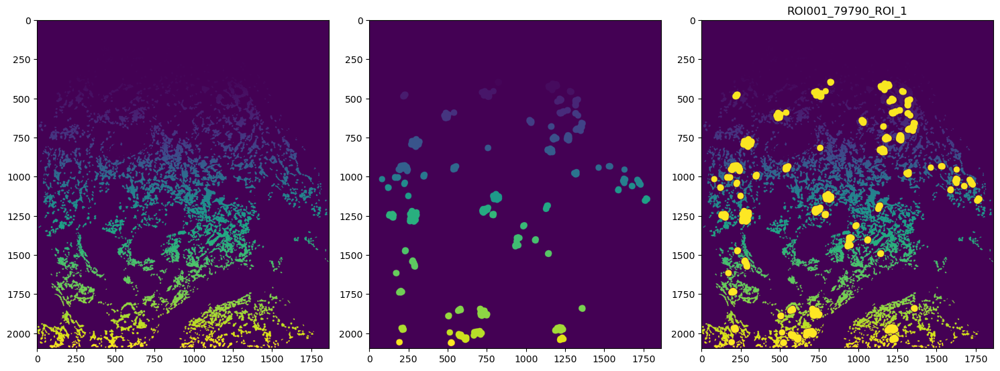

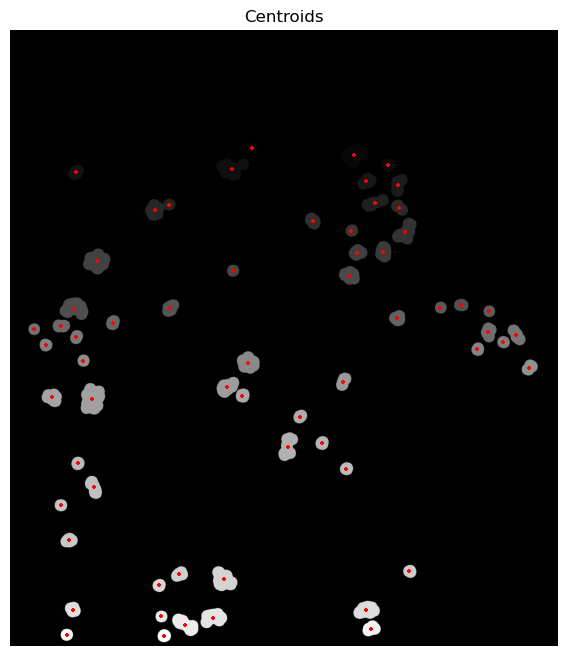

In [42]:
library_id=libraries[18]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=500,max_size=6000,window=15,pixels=5)

In [43]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

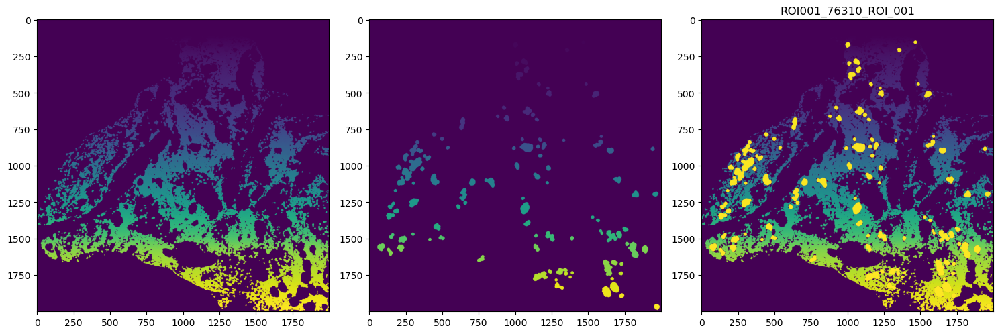

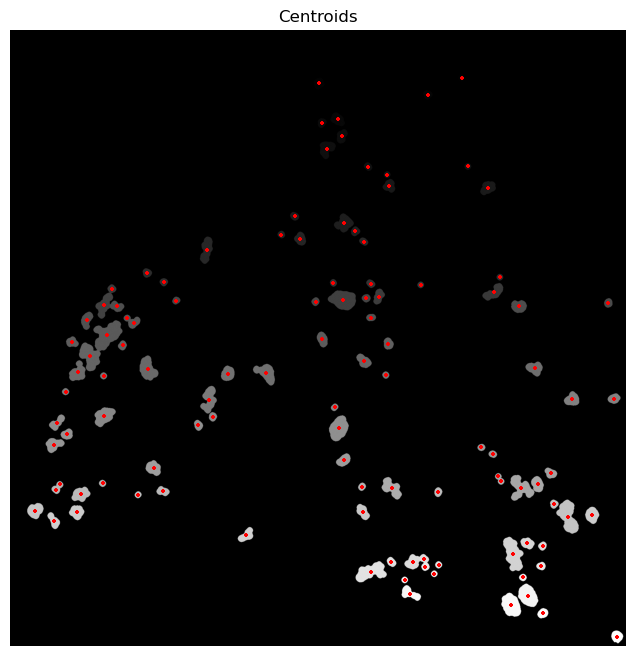

In [44]:
library_id=libraries[19]
df,new_seg=test_params(adata,library_id,sigma=1,min_size=100,max_size=5000,window=7,pixels=4)

In [45]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

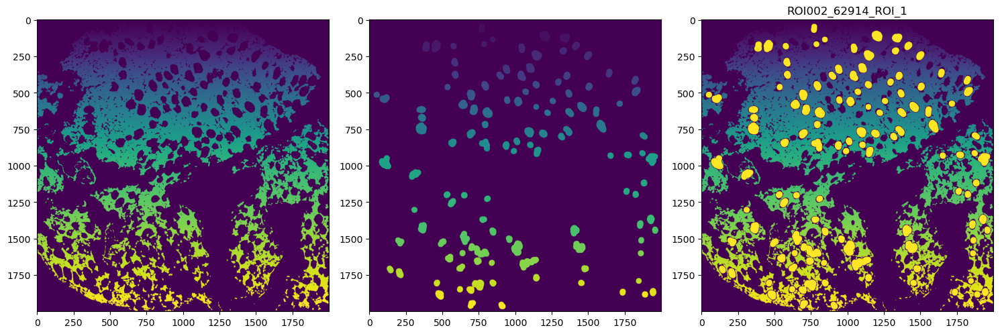

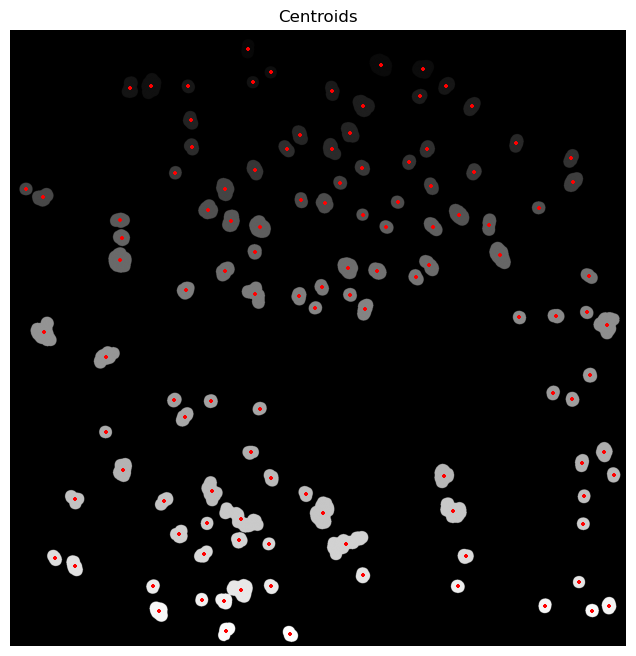

In [46]:
library_id=libraries[20]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=50,max_size=6000,window=15,pixels=5)

In [47]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

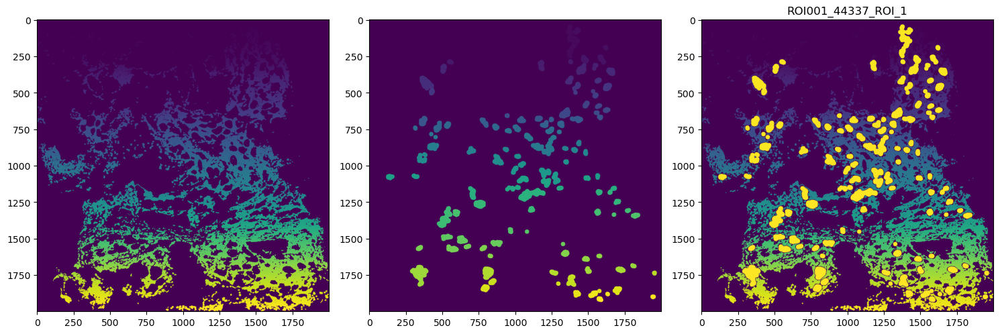

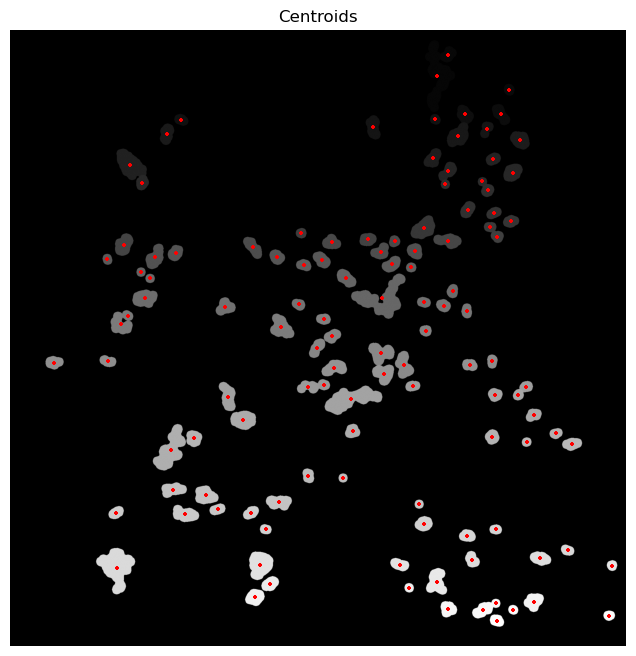

In [48]:
library_id=libraries[21]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=50,max_size=8500,window=10,pixels=5)

In [49]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

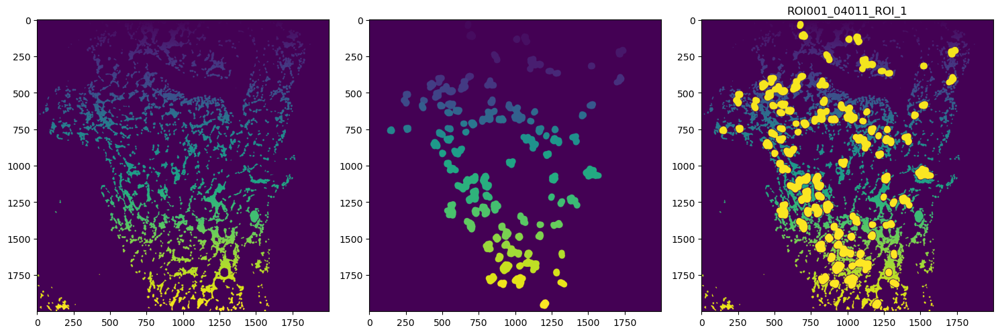

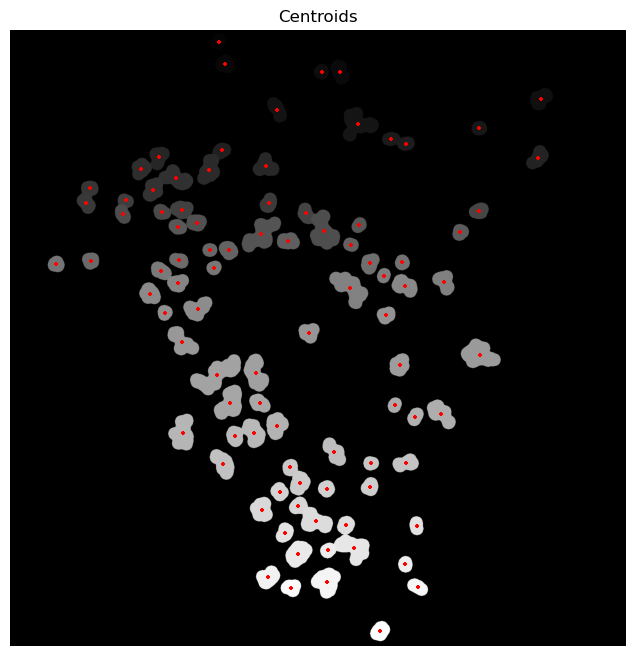

In [50]:
library_id=libraries[22]
df,new_seg=test_params(adata,library_id,sigma=4,min_size=500,max_size=6000,window=10,pixels=11)

In [51]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

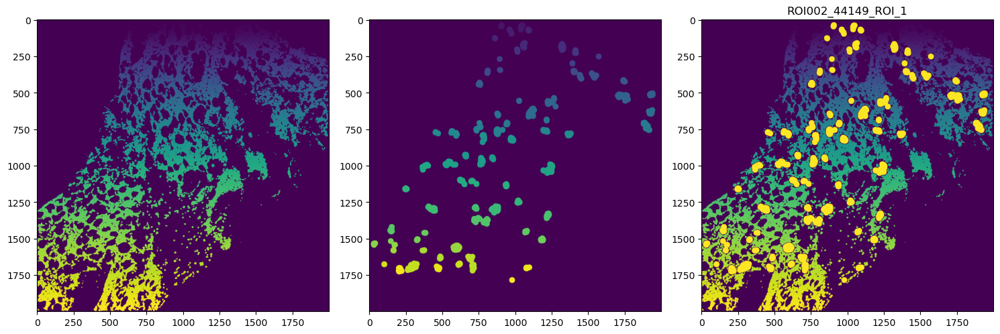

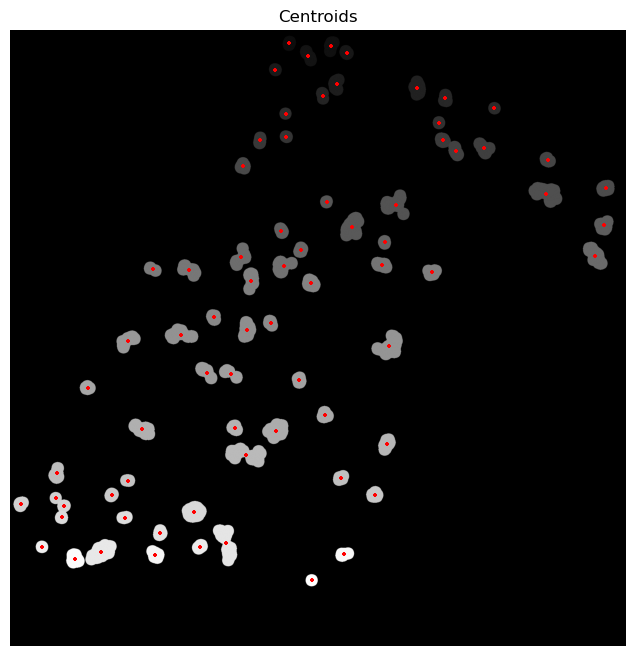

In [52]:
library_id=libraries[23]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=50,max_size=6000,window=15,pixels=5)

In [53]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

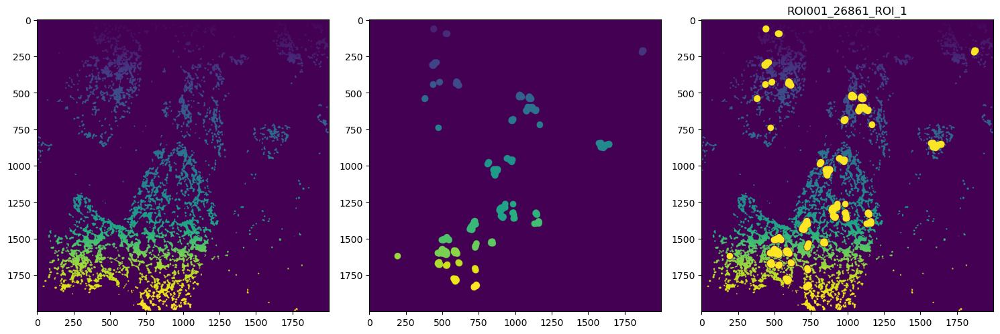

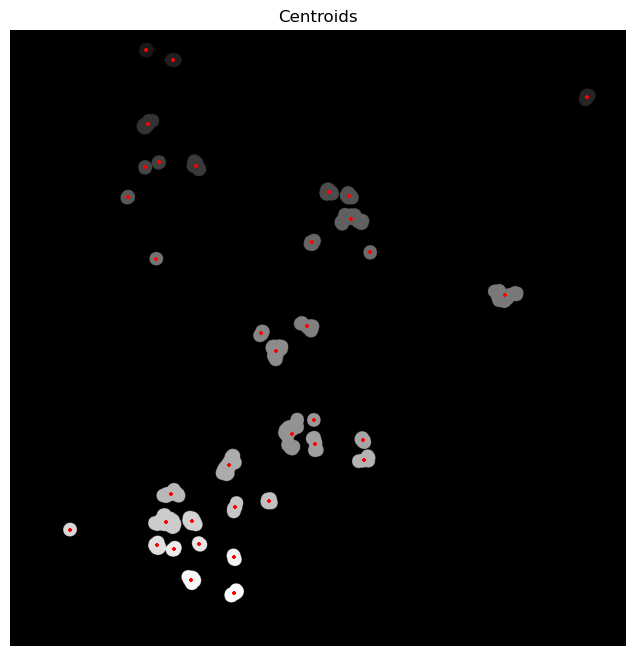

In [54]:
library_id=libraries[24]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=50,max_size=6000,window=17,pixels=5)

In [55]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

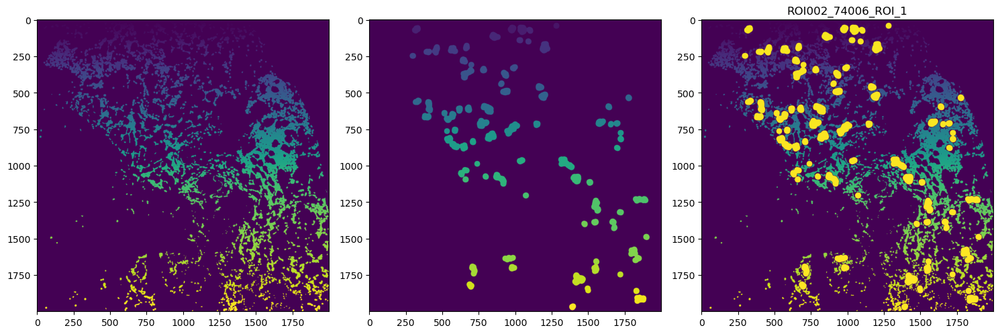

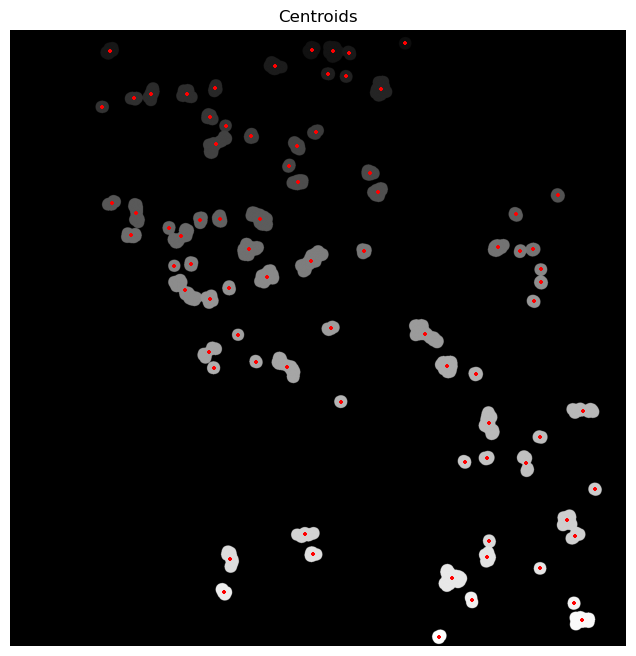

In [56]:
library_id=libraries[25]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=50,max_size=6000,window=15,pixels=5)

In [57]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

In [58]:
# library_id=libraries[26]
# df,new_seg=test_params(adata,library_id,sigma=10,min_size=10,max_size=6000,window=7,pixels=20)

In [59]:
# adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

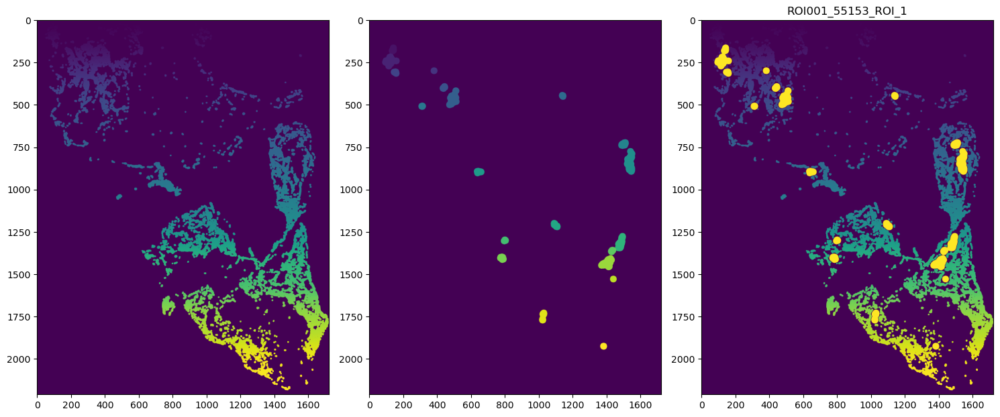

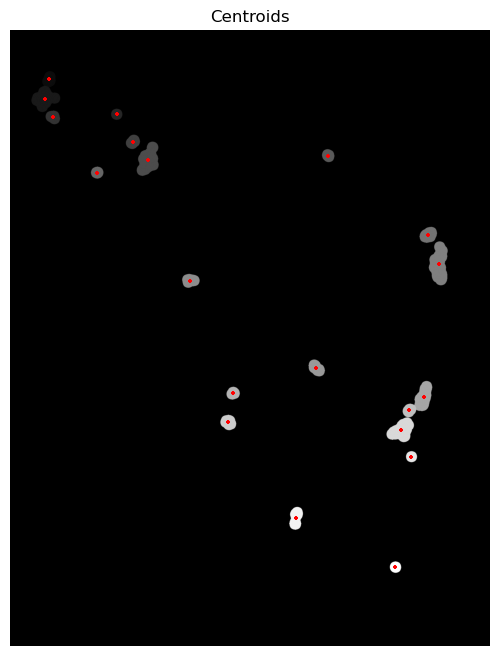

In [60]:
library_id=libraries[27]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=500,max_size=6000,window=15,pixels=5)

In [61]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

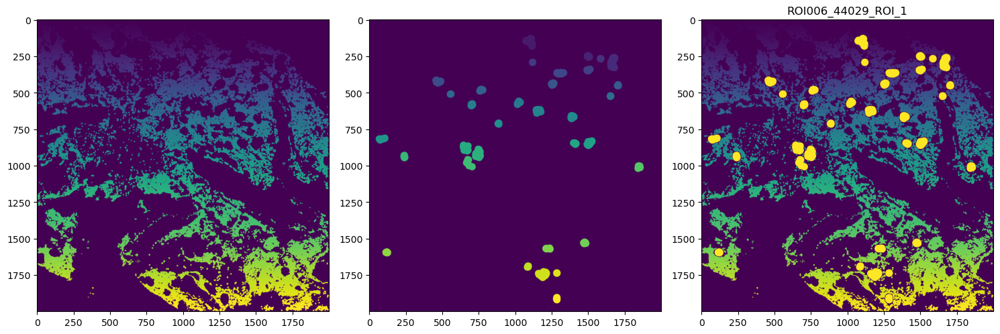

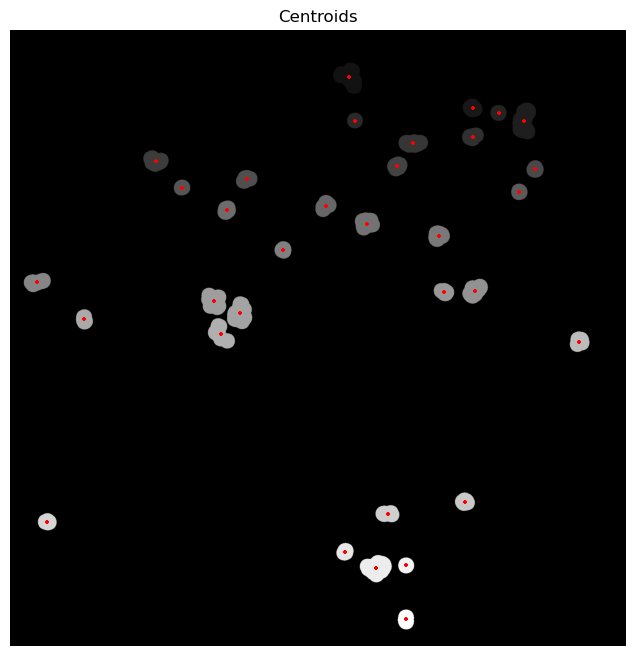

In [62]:
library_id=libraries[28]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=50,max_size=6000,window=20,pixels=5)

In [63]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

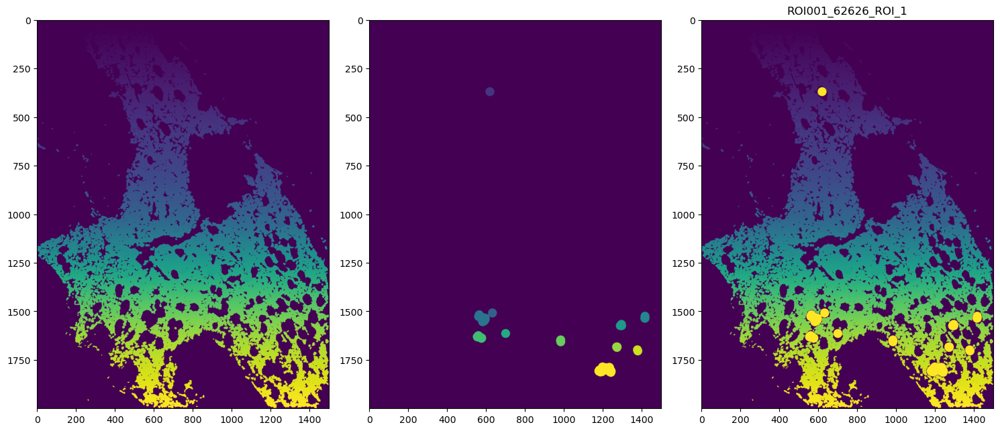

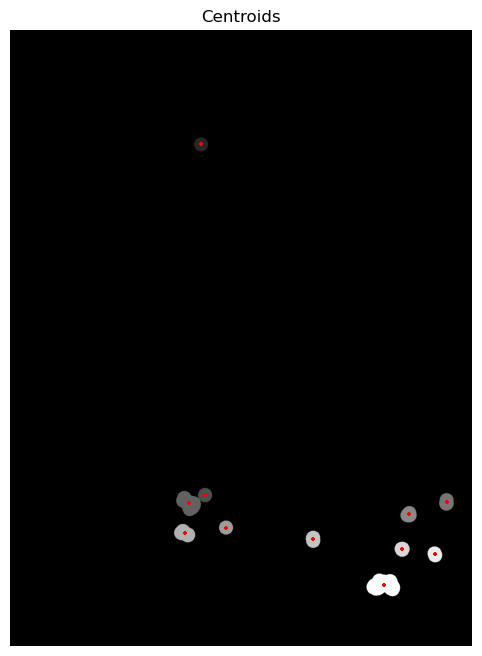

In [64]:
library_id=libraries[29]
df,new_seg=test_params(adata,library_id,sigma=1,min_size=50,max_size=7000,window=20,pixels=3)

In [65]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

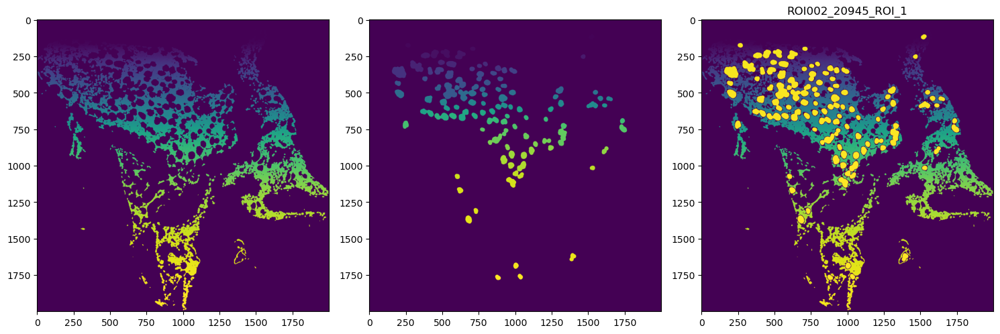

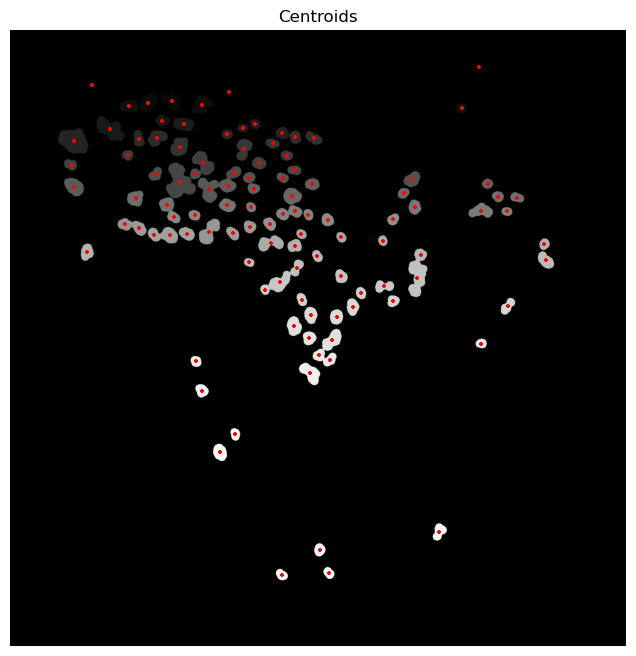

In [66]:
library_id=libraries[30]
df,new_seg=test_params(adata,library_id,sigma=1.5,min_size=500,max_size=6000,window=10,pixels=3)

In [67]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

In [68]:
# library_id=libraries[31]
# df,new_seg=test_params(adata,library_id,sigma=4,min_size=50,max_size=6000,window=1,pixels=8)

In [69]:
# adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

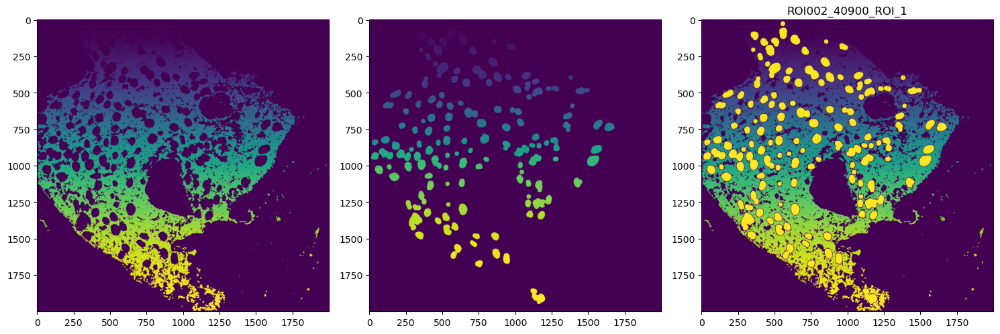

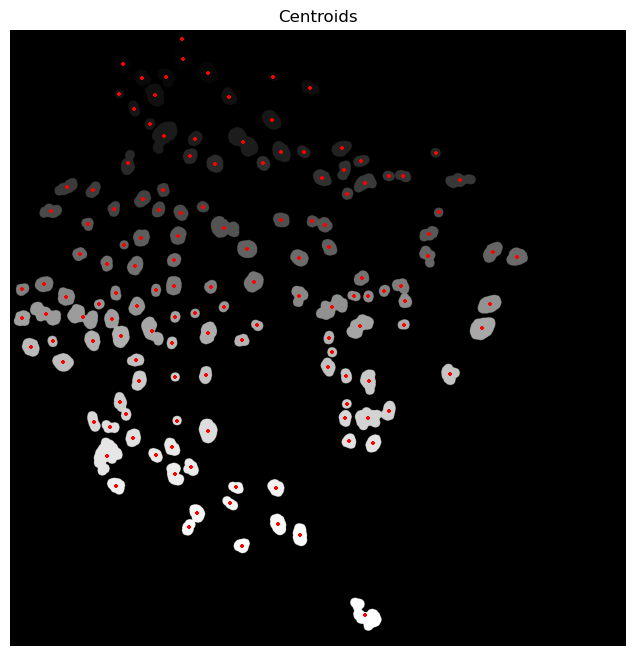

In [70]:
library_id=libraries[32]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=100,max_size=6000,window=10,pixels=5)

In [71]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

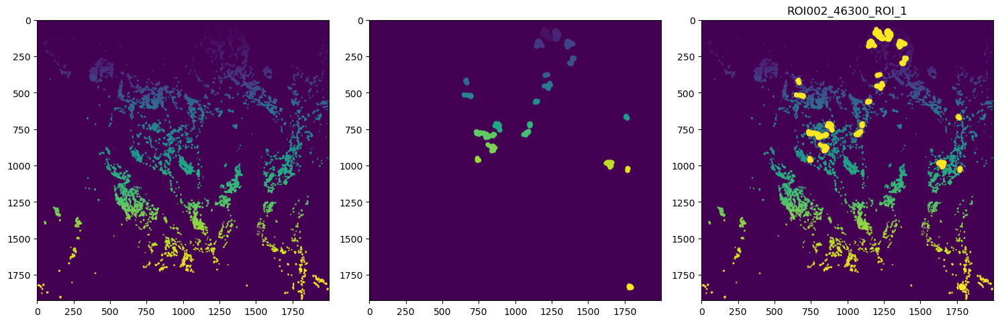

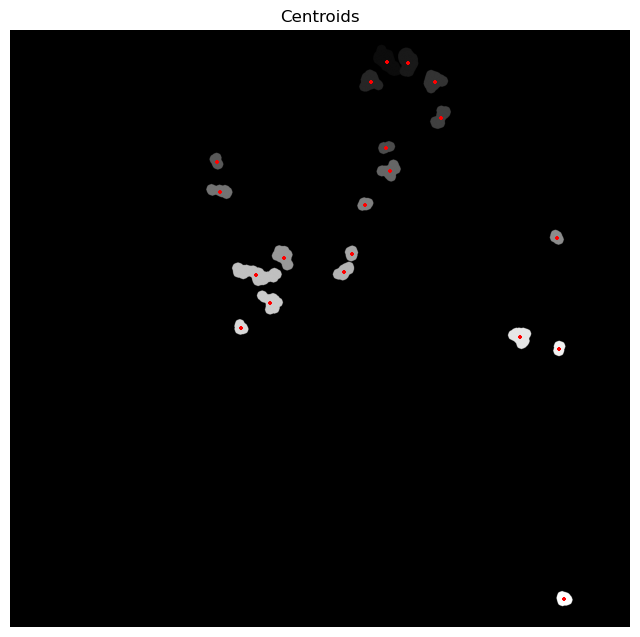

In [72]:
library_id=libraries[33]
df,new_seg=test_params(adata,library_id,sigma=3,min_size=500,max_size=5000,window=8,pixels=8)

In [73]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

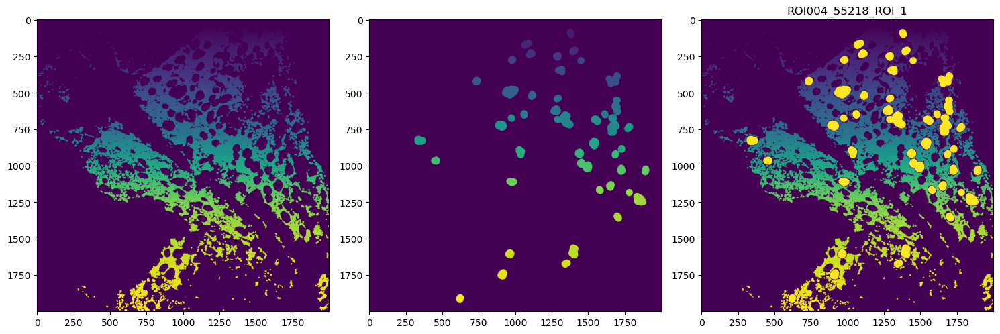

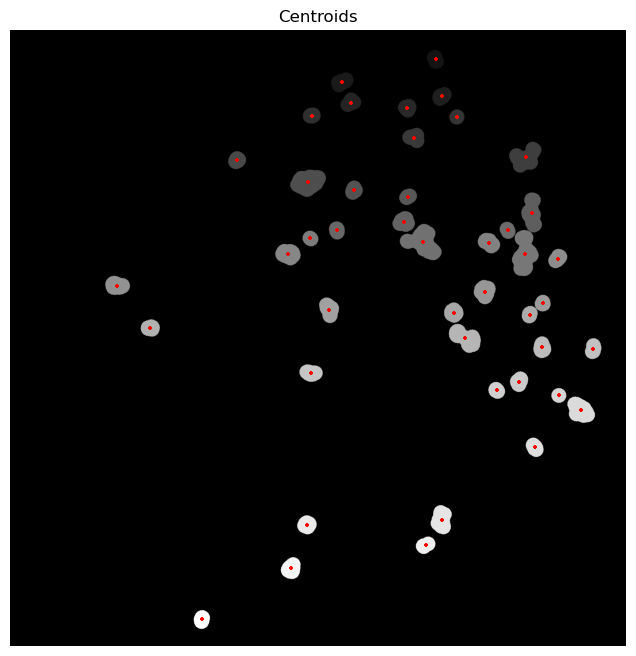

In [74]:
library_id=libraries[34]
df,new_seg=test_params(adata,library_id,sigma=1.7,min_size=50,max_size=8000,window=20,pixels=4)

In [75]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

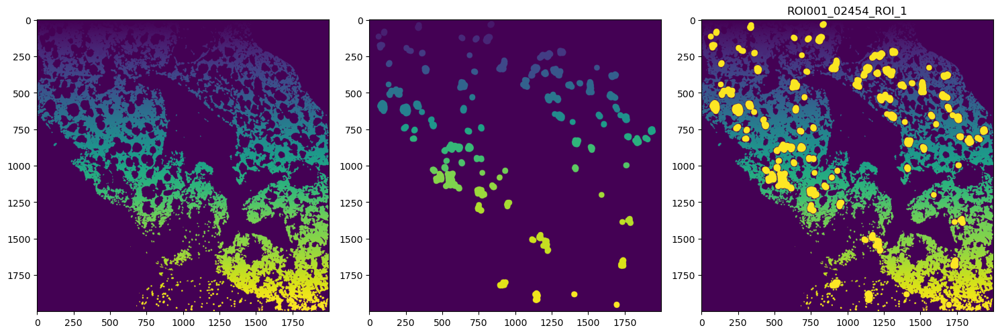

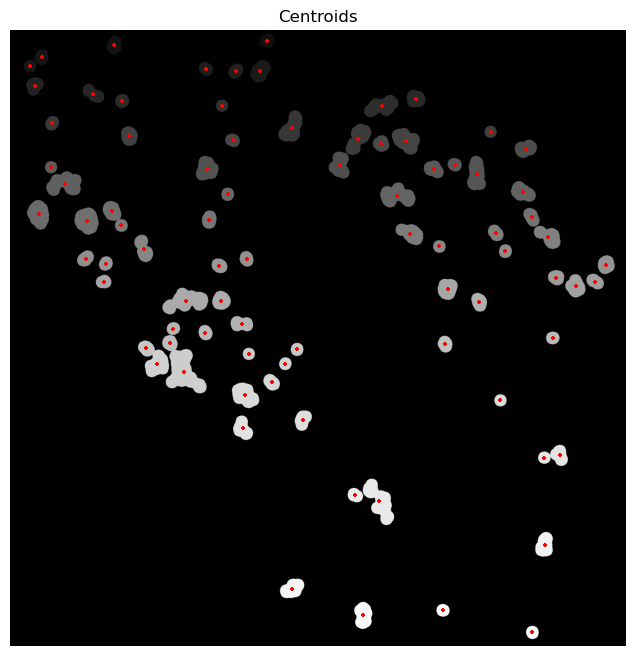

In [76]:
library_id=libraries[35]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=50,max_size=9000,window=15,pixels=5)

In [77]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

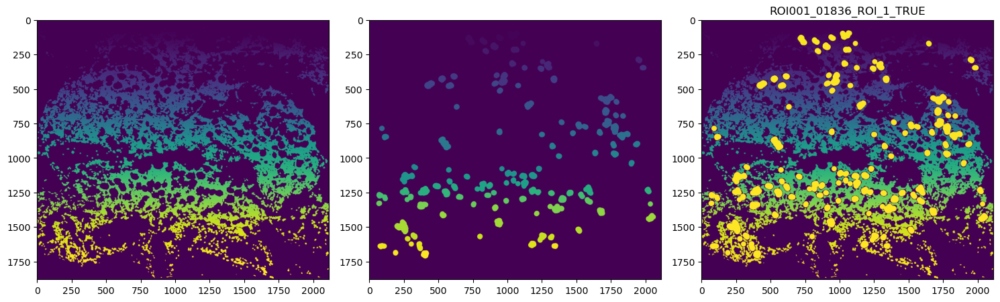

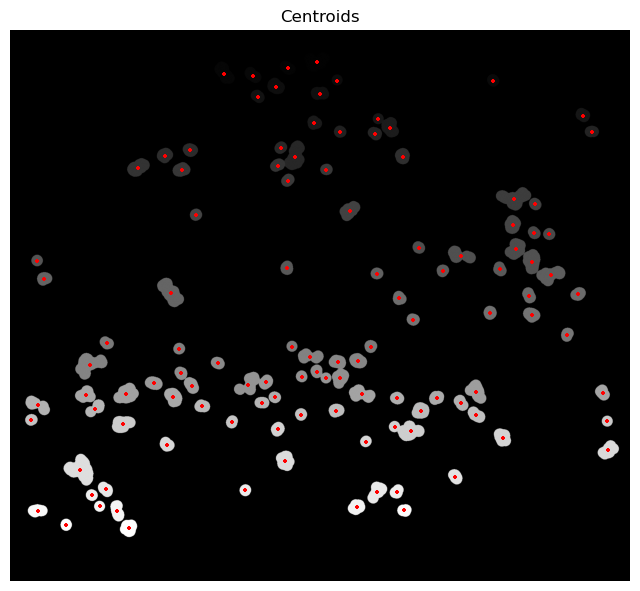

In [78]:
library_id=libraries[36]
df,new_seg=test_params(adata,library_id,sigma=1.5,min_size=50,max_size=6000,window=15,pixels=4)

In [79]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

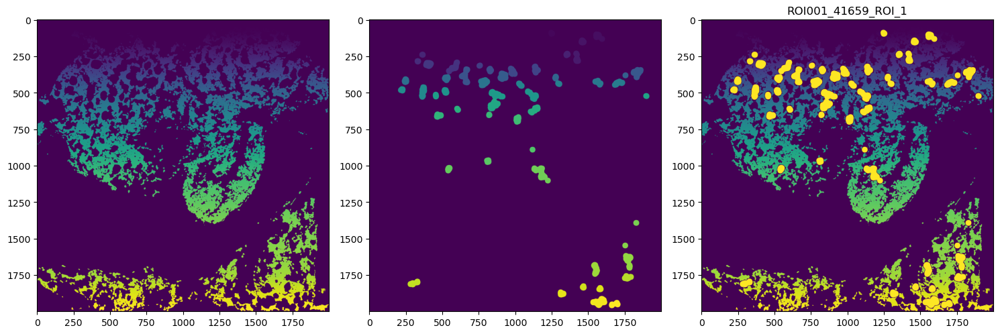

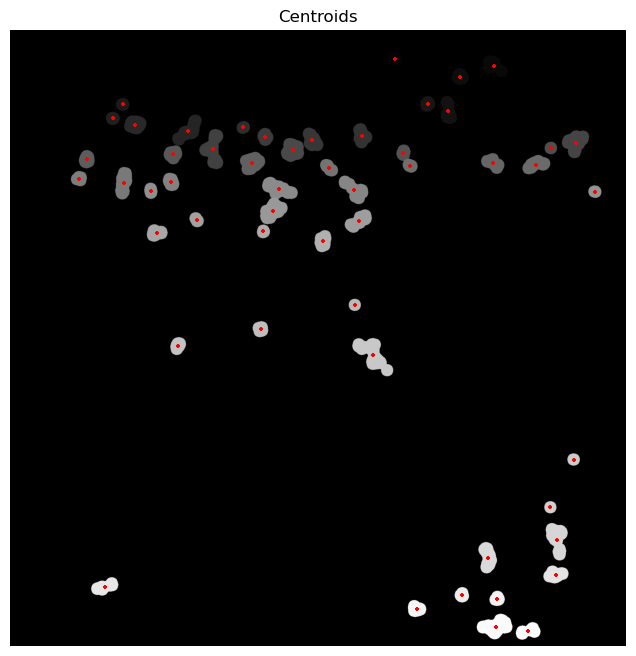

In [80]:
library_id=libraries[37]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=50,max_size=6000,window=15,pixels=5)

In [81]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

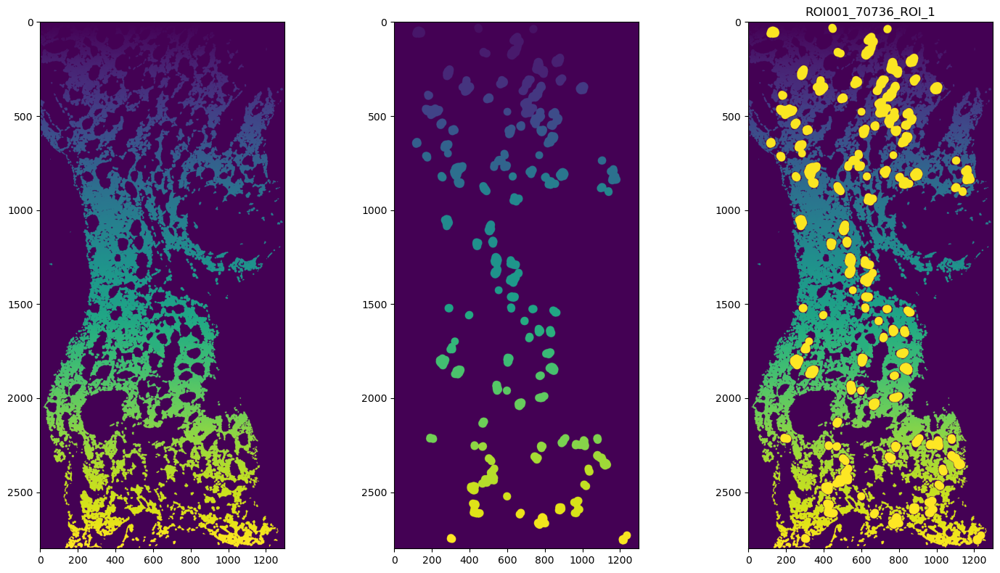

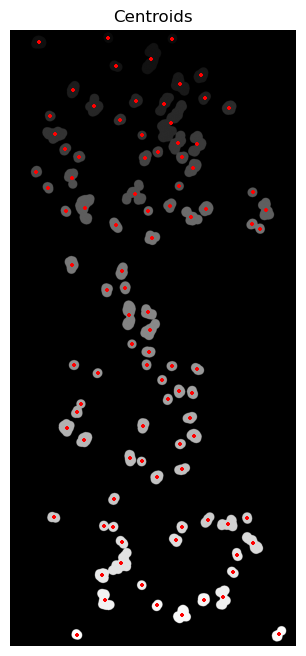

In [82]:
library_id=libraries[38]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=50,max_size=6000,window=15,pixels=6)

In [83]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

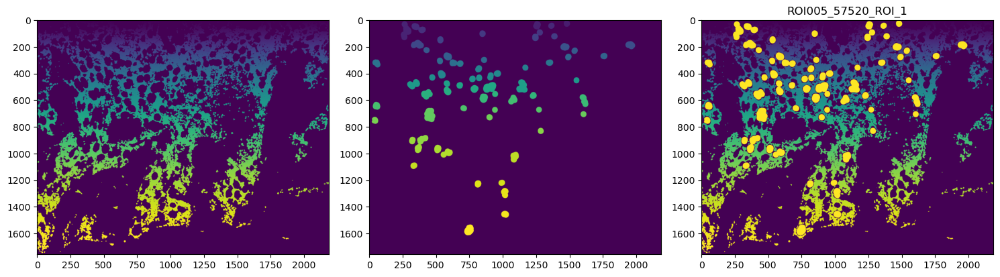

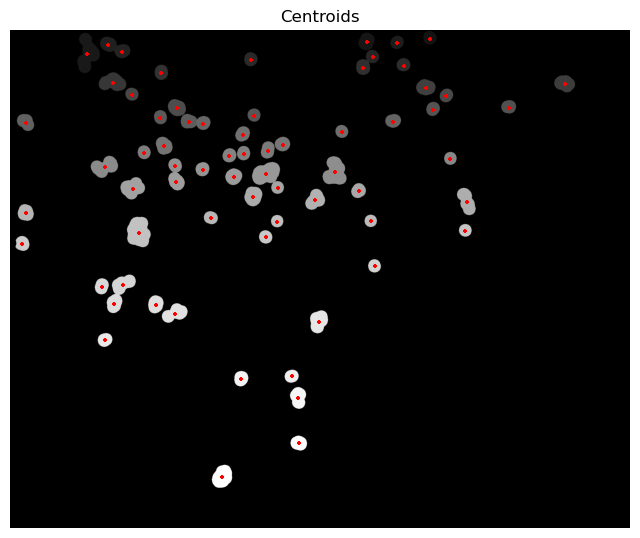

In [84]:
library_id=libraries[39]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=50,max_size=6000,window=17,pixels=5)

In [85]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

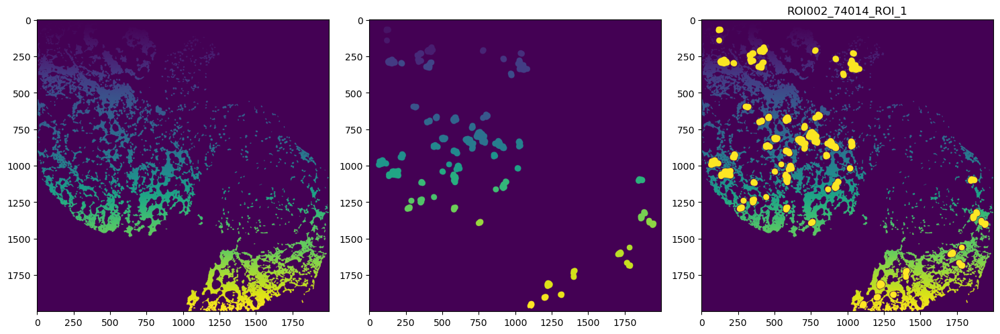

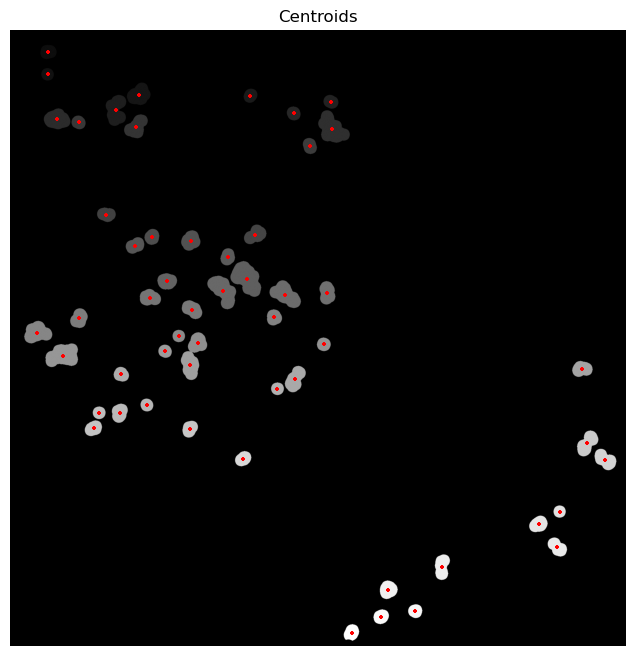

In [86]:
library_id=libraries[40]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=50,max_size=6000,window=15,pixels=5)

In [87]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

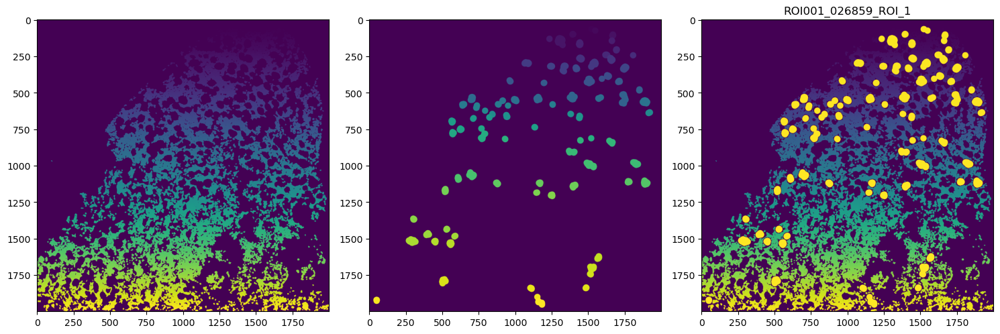

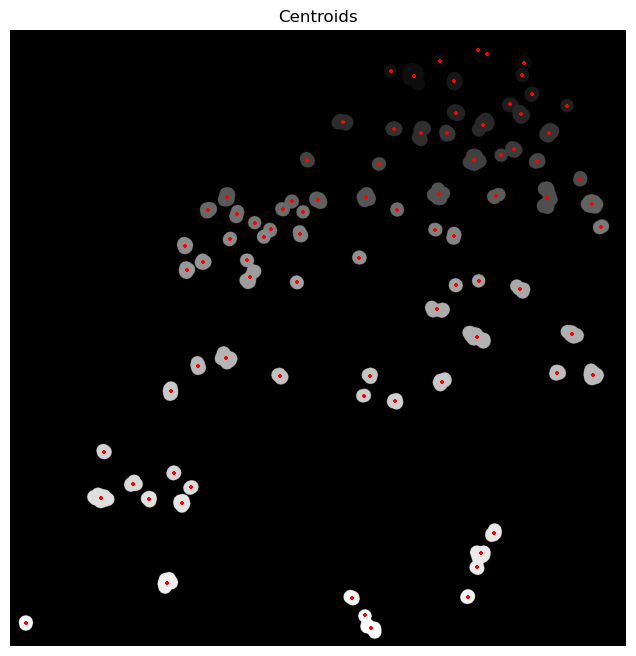

In [88]:
library_id=libraries[41]
df,new_seg=test_params(adata,library_id,sigma=4,min_size=5,max_size=3000,window=10,pixels=12)

In [89]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

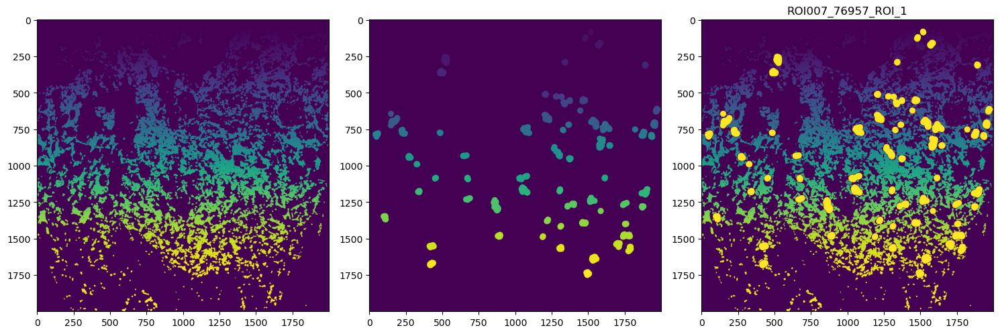

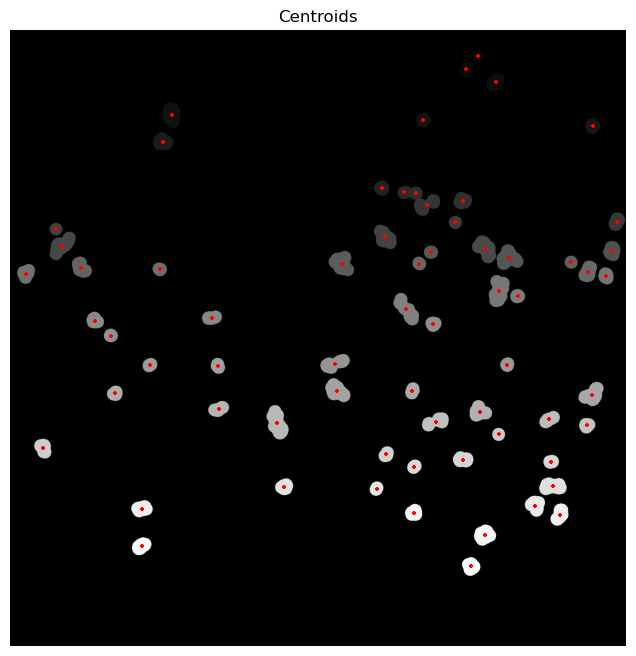

In [90]:
library_id=libraries[42]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=50,max_size=4000,window=15,pixels=6)

In [91]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

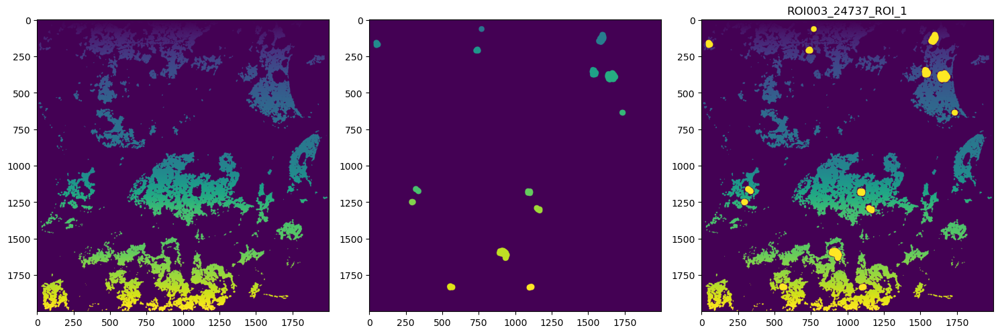

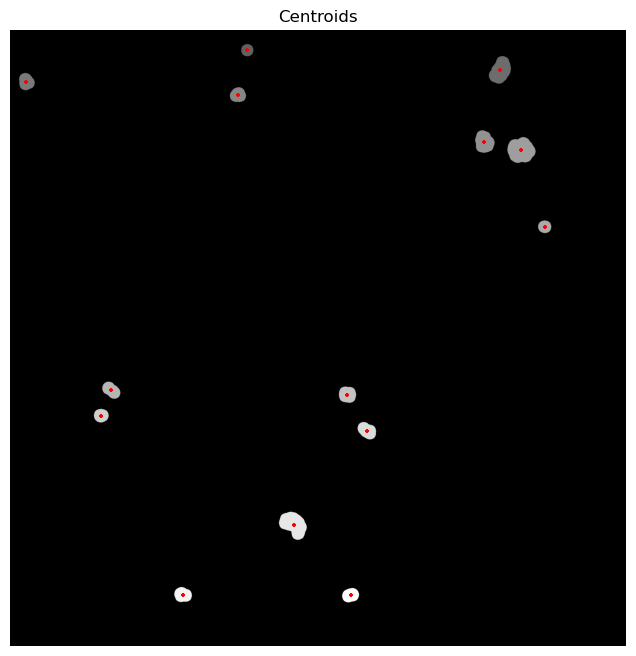

In [92]:
library_id=libraries[43]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=50,max_size=6000,window=15,pixels=5)

In [93]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

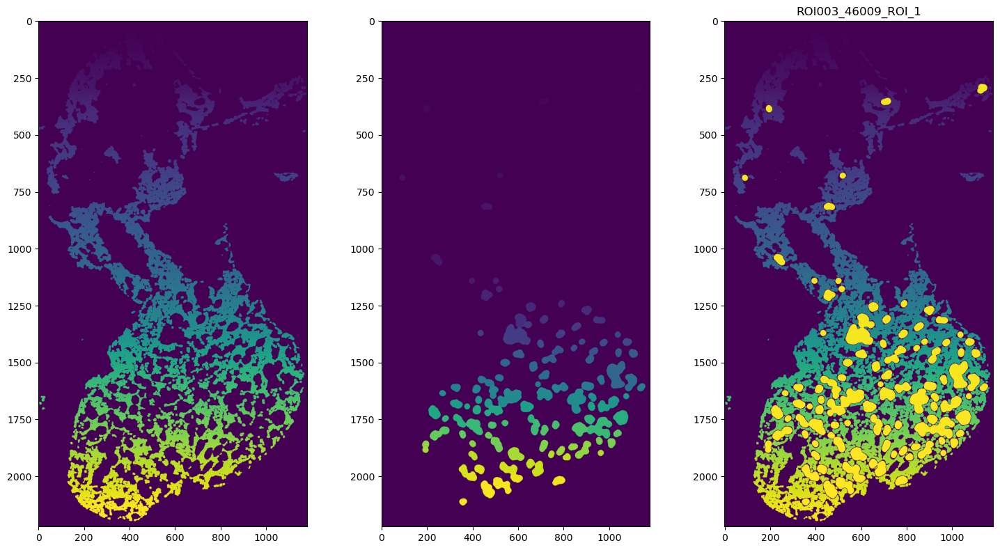

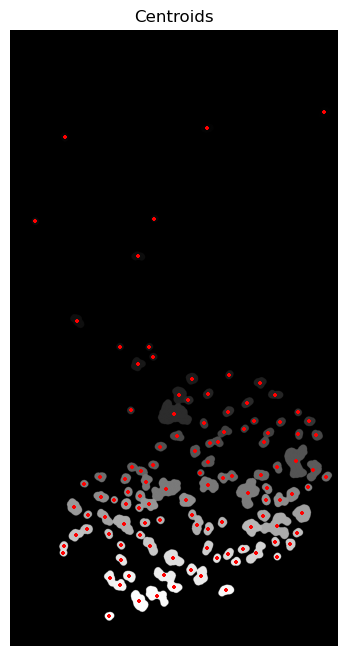

In [94]:
library_id=libraries[44]
df,new_seg=test_params(adata,library_id,sigma=3,min_size=5,max_size=6000,window=4,pixels=9)

In [95]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

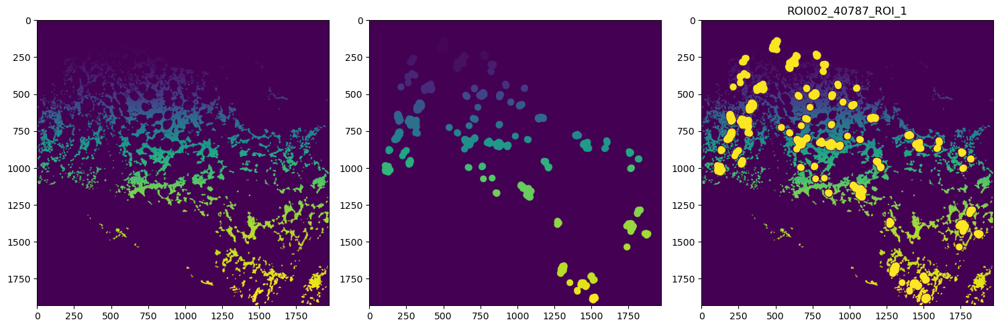

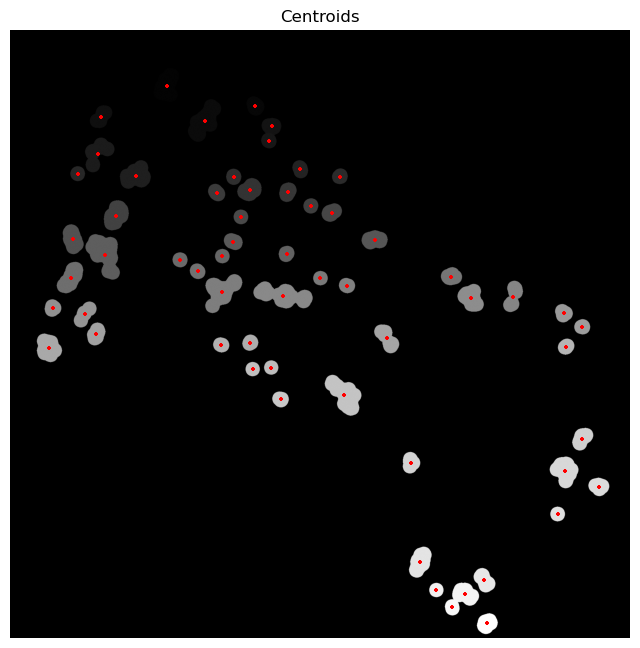

In [96]:
library_id=libraries[45]
df,new_seg=test_params(adata,library_id,sigma=2.5,min_size=10,max_size=9000,window=18,pixels=5)

In [97]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

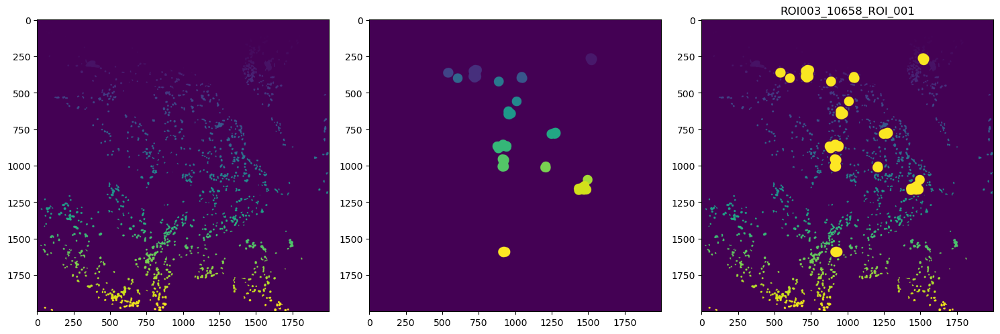

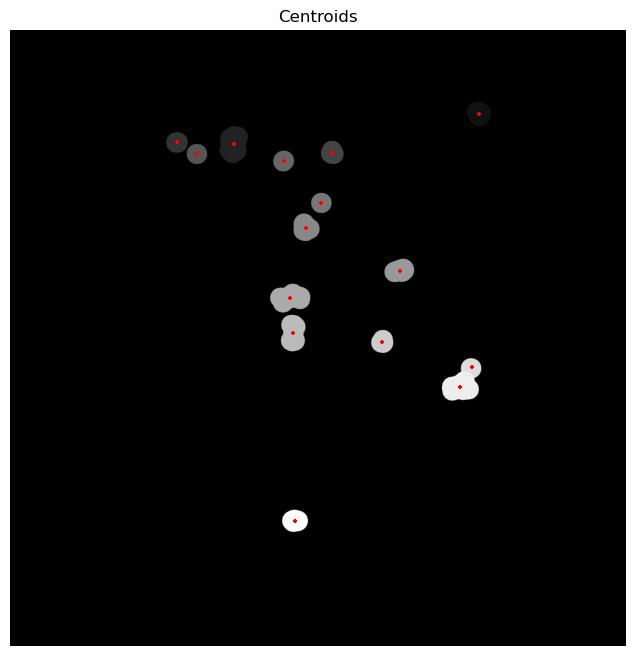

In [98]:
library_id=libraries[46]
df,new_seg=test_params(adata,library_id,sigma=8,min_size=50,max_size=6000,window=20,pixels=13)

In [99]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

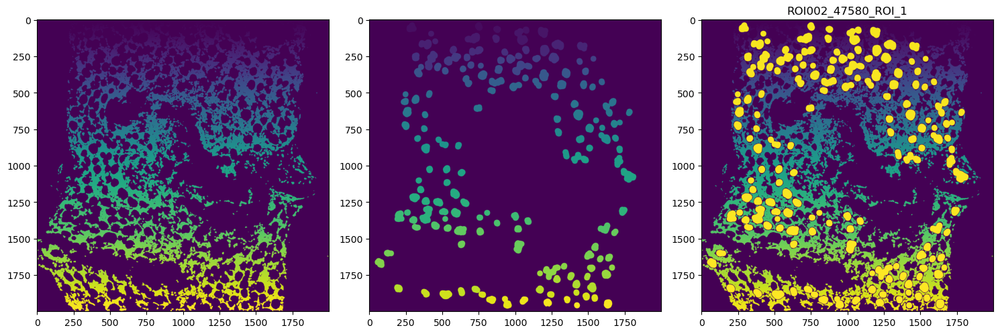

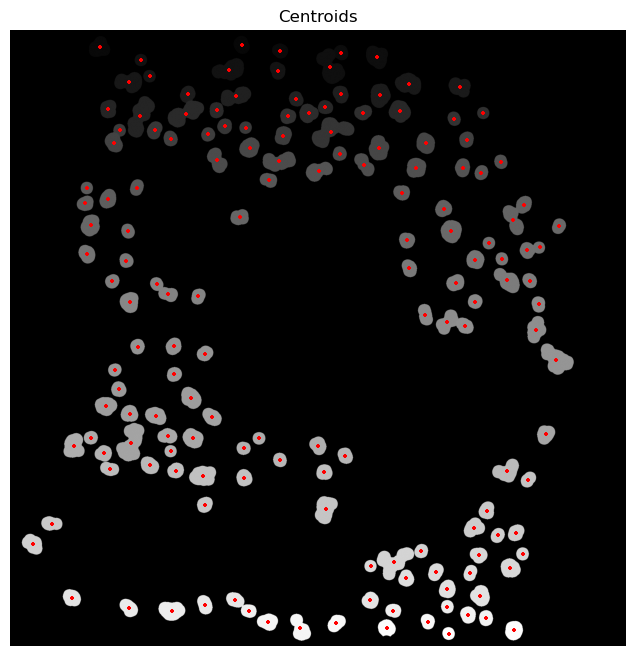

In [100]:
library_id=libraries[47]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=10,max_size=6000,window=15,pixels=5)

In [101]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

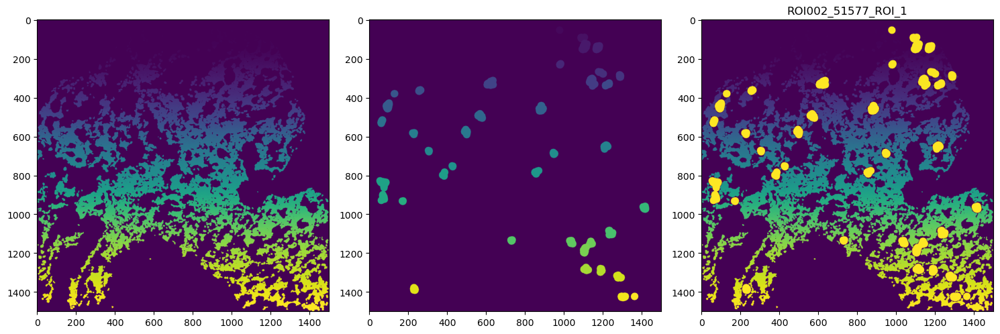

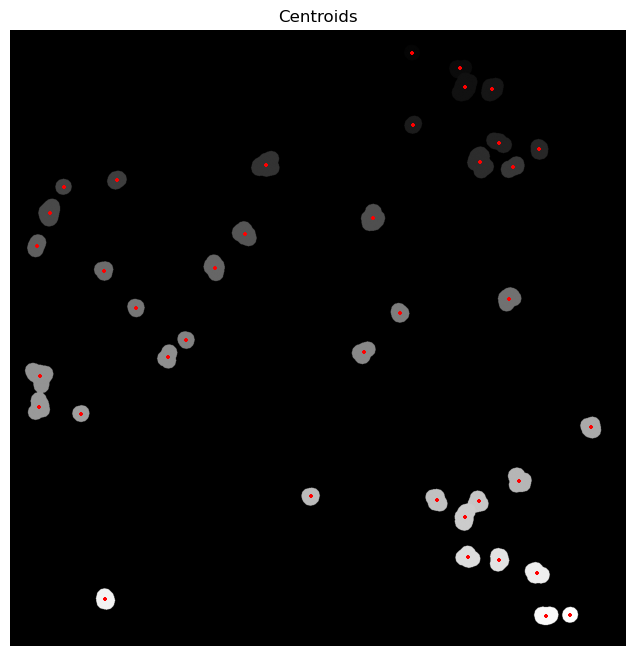

In [102]:
library_id=libraries[48]
df,new_seg=test_params(adata,library_id,sigma=3,min_size=50,max_size=2000,window=10,pixels=9)

In [103]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

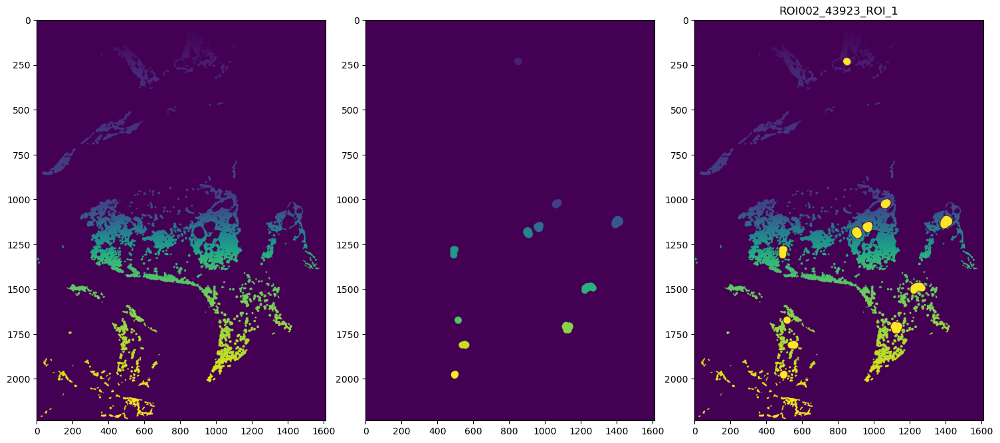

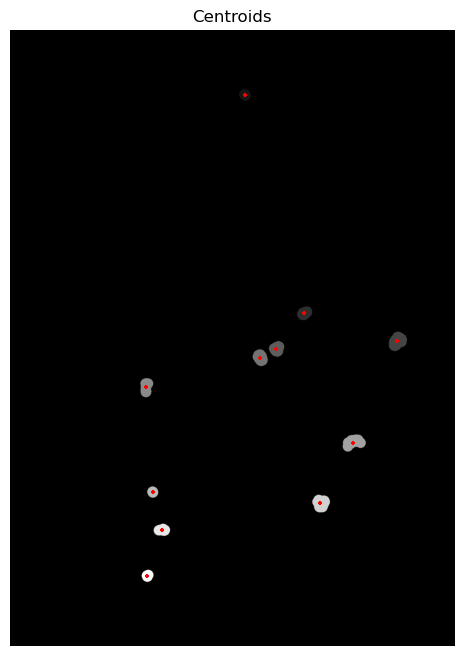

In [104]:
library_id=libraries[49]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=600,max_size=6000,window=15,pixels=4)

In [105]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

In [106]:
# library_id=libraries[50]
# df,new_seg=test_params(adata,library_id,sigma=3,min_size=50,max_size=6000,window=20,pixels=7)

In [107]:
# adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

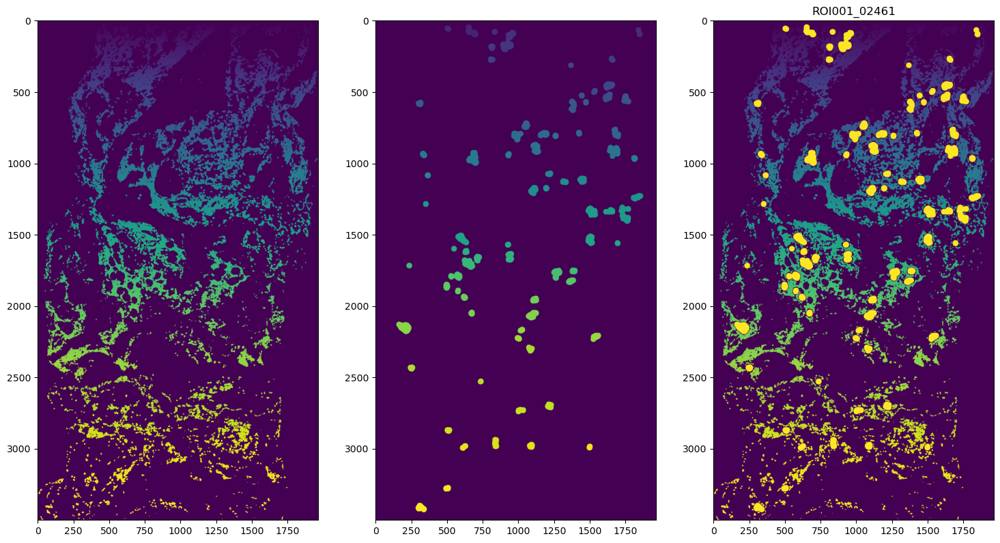

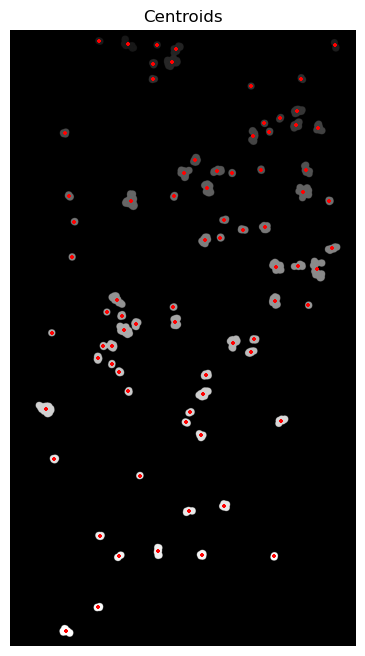

In [108]:
library_id=libraries[51]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=50,max_size=6000,window=15,pixels=5)

In [109]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

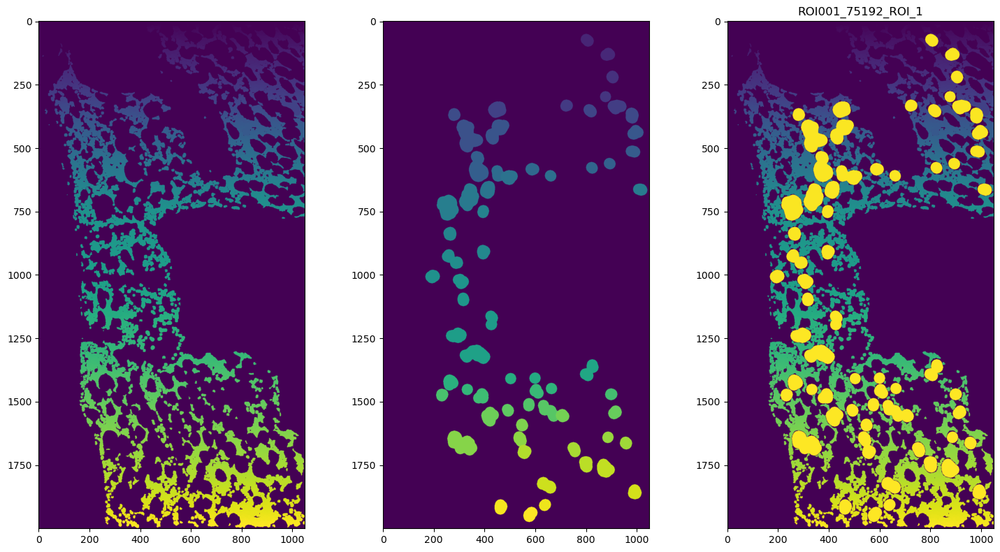

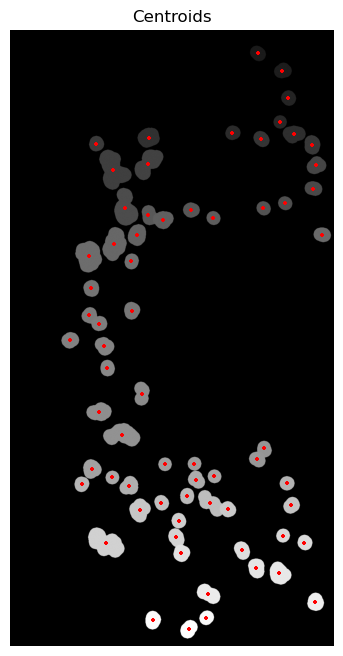

In [110]:
library_id=libraries[52]
df,new_seg=test_params(adata,library_id,sigma=3,min_size=50,max_size=6000,window=12,pixels=10)

In [111]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

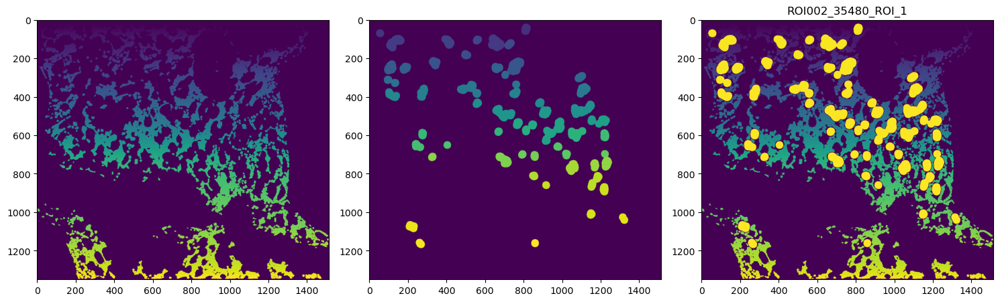

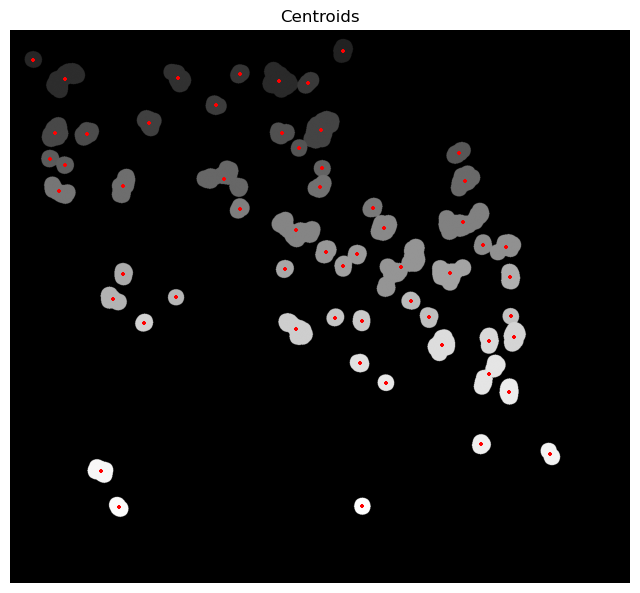

In [112]:
library_id=libraries[53]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=50,max_size=6000,window=15,pixels=5)

In [113]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

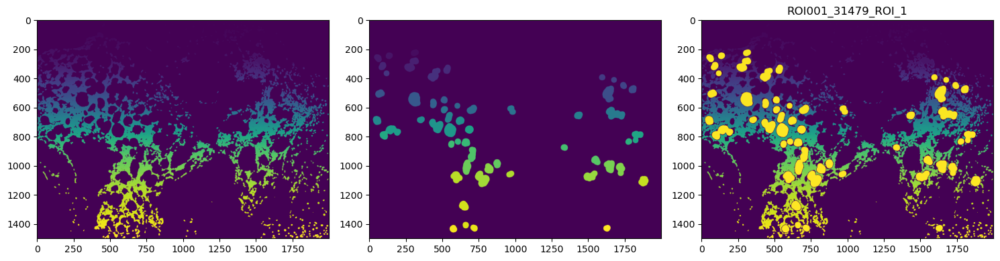

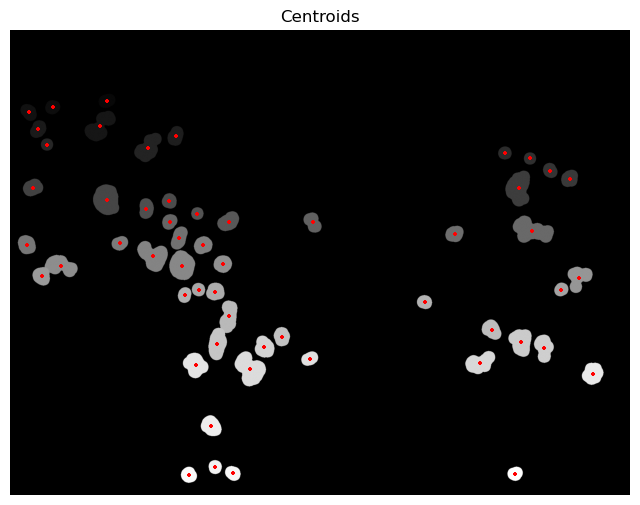

In [114]:
library_id=libraries[54]
df,new_seg=test_params(adata,library_id,sigma=2,min_size=50,max_size=6000,window=15,pixels=5)

In [115]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

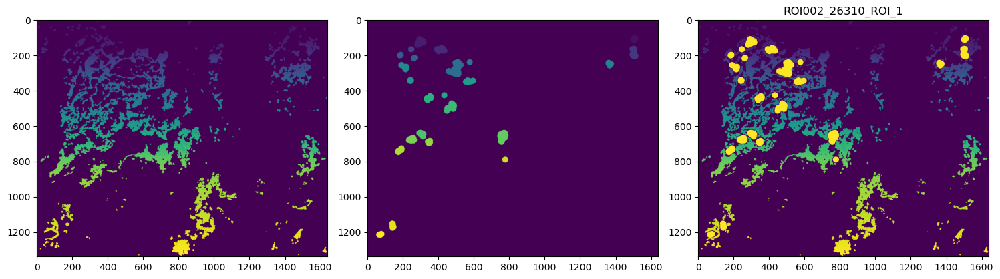

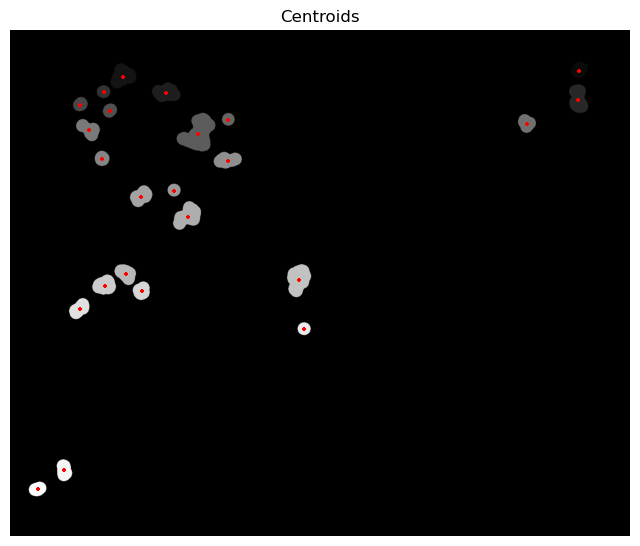

In [116]:
library_id=libraries[55]
df,new_seg=test_params(adata,library_id,sigma=2.2,min_size=5,max_size=6000,window=12,pixels=5)

In [117]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

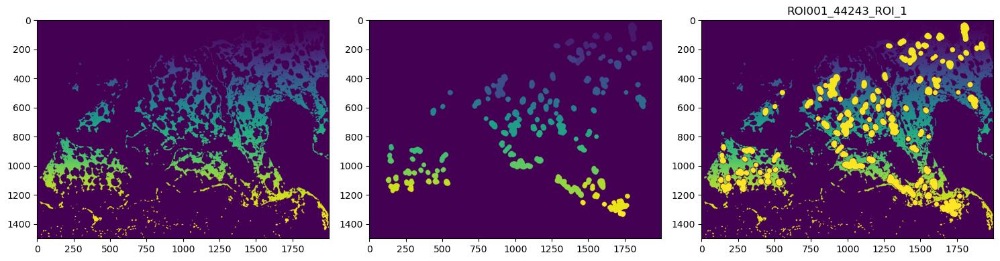

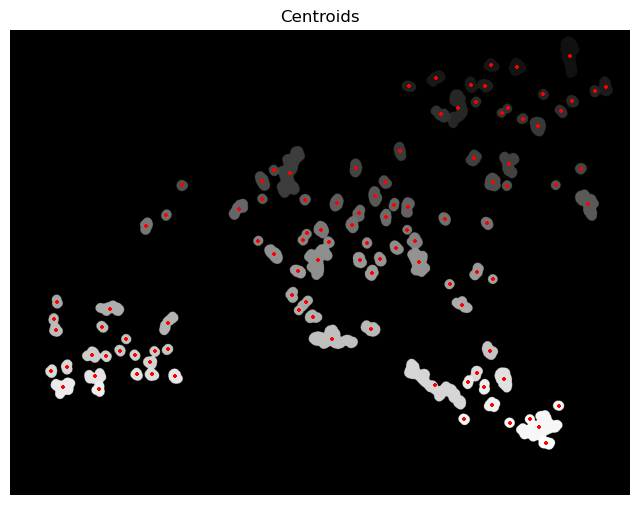

In [118]:
library_id=libraries[56]
df,new_seg=test_params(adata,library_id,sigma=3,min_size=10,max_size=6000,window=7,pixels=9)

In [119]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

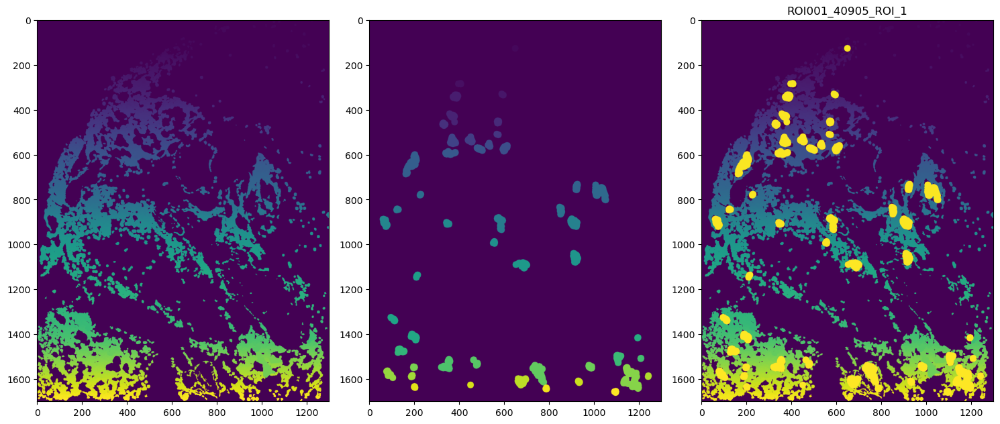

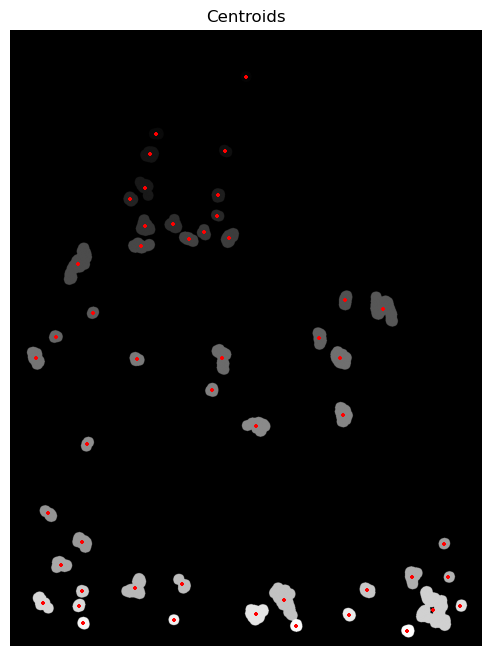

In [120]:
library_id=libraries[57]
df,new_seg=test_params(adata,library_id,sigma=1,min_size=50,max_size=6000,window=10,pixels=5)

In [121]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

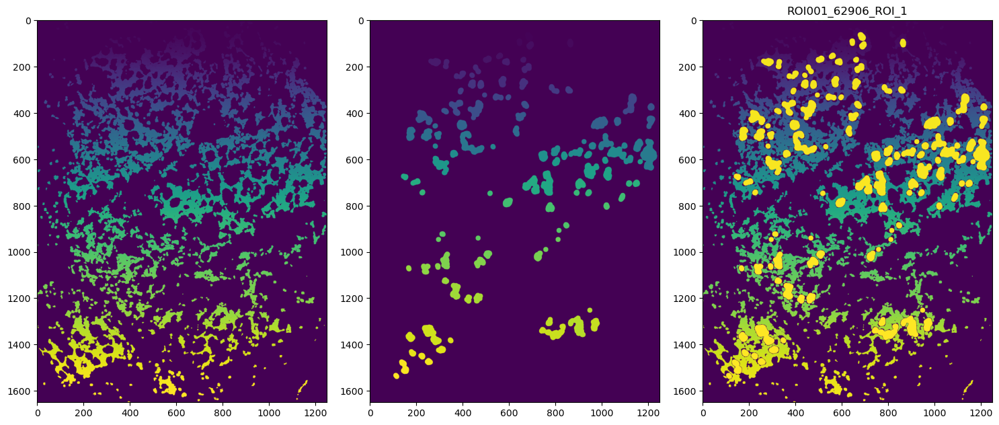

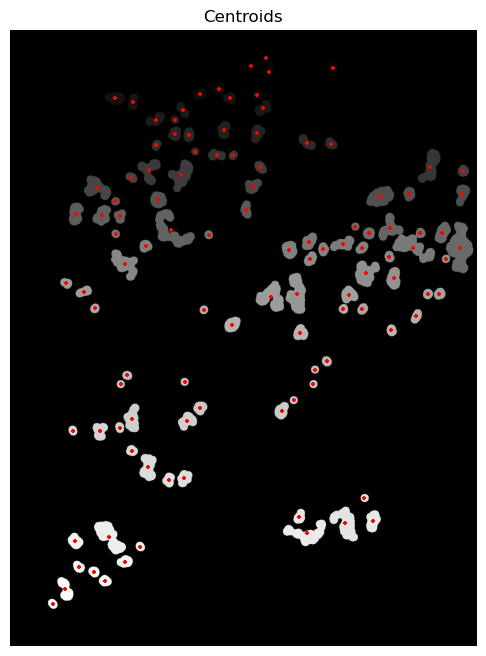

In [122]:
library_id=libraries[58]
df,new_seg=test_params(adata,library_id,sigma=.5,min_size=5,max_size=6000,window=10,pixels=1)

In [123]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

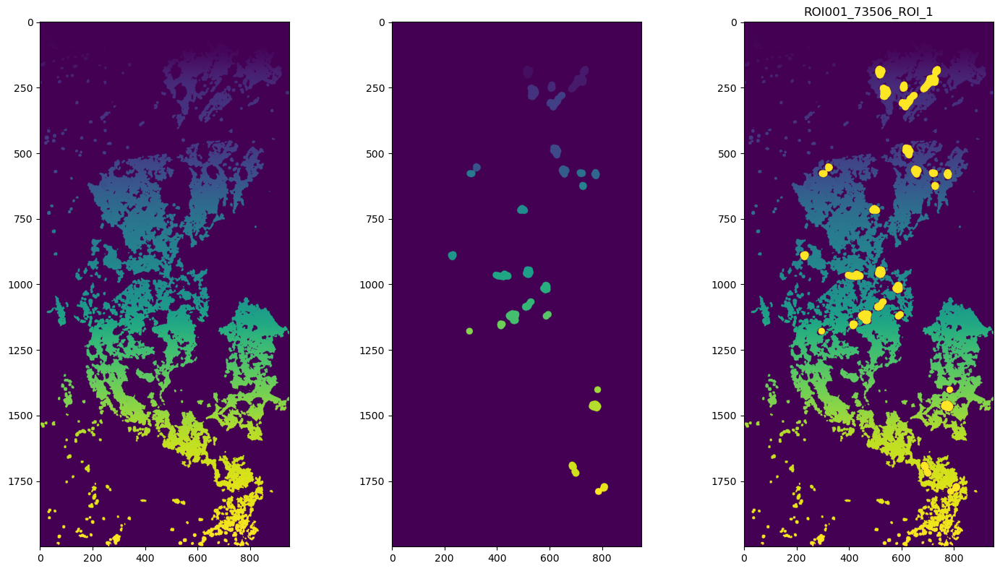

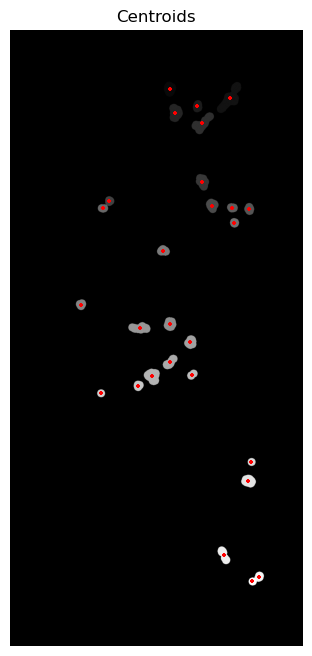

In [124]:
library_id=libraries[59]
df,new_seg=test_params(adata,library_id,sigma=1,min_size=10,max_size=3000,window=10,pixels=3)

In [125]:
adata=update_adata(adata,df,library_id,missing_cols,cell_annot_key,new_seg)

In [126]:
adata.write('data/non_denoised/spe_final_adipocytes.h5ad')